# DSPT7 Unit 2 Build Week Project:

## Predicting the frequency of the shape of reported UFO's in North America

* Source for my original dataset: [UFO Sightings from Kaggle]('https://www.kaggle.com/NUFORC/ufo-sightings?select=scrubbed.csv')  
* Based on data from: [National UFO Reporting Center (NUFORC)]('http://www.nuforc.org/')
  

## Start Code:

In [1]:
%%capture
import sys

# If you're on Colab:
if 'google.colab' in sys.modules:
    DATA_PATH = 'https://www.kaggle.com/NUFORC/ufo-sightings?select=scrubbed.csv'
    !pip install category_encoders==2.*
    !pip install pandas-profiling==2.*
    
# If you're working locally:
else:
    DATA_PATH = '../data/'
#     !pip install category_encoders==2.*
#     !pip install pandas-profiling==2.*
#     !pip install plotly==4.9.0

## Imports:

In [2]:
# Imports:
import pandas as pd
import pandas_profiling
from pandas_profiling import ProfileReport
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import IPython
from IPython.display import HTML
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
import plotly as py
from plotly.graph_objs import *
import plotly.express as px
from plotly.subplots import make_subplots
import category_encoders as ce
from sklearn.impute import SimpleImputer
from sklearn.metrics import accuracy_score, plot_confusion_matrix, classification_report
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.inspection import permutation_importance
import eli5
from eli5.sklearn import PermutationImportance
from sklearn.compose import ColumnTransformer
from pdpbox import pdp
from pdpbox.pdp import pdp_isolate, pdp_plot, pdp_interact, pdp_interact_plot

C:\Users\sahmj\OneDrive\Documents\Anaconda\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning:

The sklearn.metrics.scorer module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.

C:\Users\sahmj\OneDrive\Documents\Anaconda\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning:

The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.



## Read in my data:

In [3]:
# Read in my data:
data = 'https://raw.githubusercontent.com/jmmiddour/Datasets/master/ufo_sightings_scrubbed.csv'
ufos = pd.read_csv(data)

# Look at the first 5 rows:
ufos.head()

,datetime,city,state,country,shape,duration (seconds),duration (hours/min),comments,date posted,latitude,longitude
0,10/10/1949 20:30,san marcos,tx,us,cylinder,2700,45 minutes,This event took place in early fall around 194...,4/27/2004,29.8830556,-97.941111
1,10/10/1949 21:00,lackland afb,tx,NaN,light,7200,1-2 hrs,1949 Lackland AFB&#44 TX. Lights racing acros...,12/16/2005,29.38421,-98.581082
2,10/10/1955 17:00,chester (uk/england),NaN,gb,circle,20,20 seconds,Green/Orange circular disc over Chester&#44 En...,1/21/2008,53.2,-2.916667
3,10/10/1956 21:00,edna,tx,us,circle,20,1/2 hour,My older brother and twin sister were leaving ...,1/17/2004,28.9783333,-96.645833
4,10/10/1960 20:00,kaneohe,hi,us,light,900,15 minutes,AS a Marine 1st Lt. flying an FJ4B fighter/att...,1/22/2004,21.4180556,-157.803611


## Pandas Profile:

In [4]:
# Look at the profile for this dataset:
profile = ProfileReport(ufos, title='UFO Sightings (Original Data Set) 1906-2014', 
                        html={'style': {'full_width':True}}, plot={'histogram': {'bins': 50}}, explorative=True)
# profile.to_notebook_iframe()
profile

In [5]:
# Turn profile report into a html file to add to blog post:
profile.to_file('UFO_pd_profile_report.html')

## Target Feature:

In [6]:
# Reduce the dimensionality of my target feature by group like variables into new classes:
ufos['shape_class'] = ufos['shape']
ufos['shape_class'] = ufos['shape_class'].replace(['other', 'unknown', np.nan], 'Other')
ufos['shape_class'] = ufos['shape_class'].replace(['circle', 'sphere', 'disk', 'round', 'oval'], 'Circular')
ufos['shape_class'] = ufos['shape_class'].replace(['triangle', 'hexagon', 'delta', 'chevron', 'rectangle', 
                                                   'diamond'], 'Geometric')
ufos['shape_class'] = ufos['shape_class'].replace(['pyramid', 'cylinder', 'egg', 'cone', 'dome', 
                                                   'cigar', 'cross', 'crescent', 'teardrop'], 'Non-Geometric')
ufos['shape_class'] = ufos['shape_class'].replace(['formation', 'changed', 'changing'], 'Multiple')
ufos['shape_class'] = ufos['shape_class'].replace(['light', 'fireball', 'flash', 'flare'], 'Type of Light')

# Check my work:
ufos['shape_class'].value_counts(normalize=True)

Type of Light    0.300030
Circular         0.273154
Other            0.163882
Geometric        0.140666
Non-Geometric    0.067246
Multiple         0.055022
Name: shape_class, dtype: float64

## Clean and explore my data:

### Dates and Times:

In [7]:
# Look at the length of a value that is the length it should be for formatting:
len(ufos['datetime'][0])

16

In [8]:
# Create a new column with length values of datetime values:
ufos['dt_len'] = ufos['datetime'].str.len()
ufos.head()

,datetime,city,state,country,shape,duration (seconds),duration (hours/min),comments,date posted,latitude,longitude,shape_class,dt_len
0,10/10/1949 20:30,san marcos,tx,us,cylinder,2700,45 minutes,This event took place in early fall around 194...,4/27/2004,29.8830556,-97.941111,Non-Geometric,16
1,10/10/1949 21:00,lackland afb,tx,NaN,light,7200,1-2 hrs,1949 Lackland AFB&#44 TX. Lights racing acros...,12/16/2005,29.38421,-98.581082,Type of Light,16
2,10/10/1955 17:00,chester (uk/england),NaN,gb,circle,20,20 seconds,Green/Orange circular disc over Chester&#44 En...,1/21/2008,53.2,-2.916667,Circular,16
3,10/10/1956 21:00,edna,tx,us,circle,20,1/2 hour,My older brother and twin sister were leaving ...,1/17/2004,28.9783333,-96.645833,Circular,16
4,10/10/1960 20:00,kaneohe,hi,us,light,900,15 minutes,AS a Marine 1st Lt. flying an FJ4B fighter/att...,1/22/2004,21.4180556,-157.803611,Type of Light,16


In [9]:
# Look at the value counts of the new column and shape of dataframe 
#   before dropping rows with strange time formatting:
print('Datetime Length Frequencies before removing rows:\n\n', ufos['dt_len'].value_counts(), '\n')
print('Number of Observations before removing rows =', ufos.shape[0], '\n')

# Drop all rows with strange time (length more than 16):
ufos = ufos.drop(ufos.loc[ufos['dt_len'] >= 17].index)

# Check my work by looking at the new value counts and shape:
print('Datetime Length Frequencies after removing rows:\n\n', ufos['dt_len'].value_counts(), '\n')
print('Number of Observations after removing rows =', ufos.shape[0])

Datetime Length Frequencies before removing rows:

 15    38698
14    25611
16    10831
13     4498
22      380
21      193
23      120
20        1
Name: dt_len, dtype: int64 

Number of Observations before removing rows = 80332 

Datetime Length Frequencies after removing rows:

 15    38698
14    25611
16    10831
13     4498
Name: dt_len, dtype: int64 

Number of Observations after removing rows = 79638


In [10]:
# Need to change datetime feature to datetime data type:
ufos['datetime'] = pd.to_datetime(ufos['datetime'], infer_datetime_format=True)

# Check my work by looking at the data type now:
ufos.dtypes

datetime                datetime64[ns]
city                            object
state                           object
country                         object
shape                           object
duration (seconds)              object
duration (hours/min)            object
comments                        object
date posted                     object
latitude                        object
longitude                      float64
shape_class                     object
dt_len                           int64
dtype: object

In [11]:
# Break down the date of the sighting:
ufos['year'] = ufos['datetime'].dt.year
ufos['month'] = ufos['datetime'].dt.month
ufos['hour'] = ufos['datetime'].dt.hour
ufos['dow'] = ufos['datetime'].dt.weekday

# Change the dow to the name of the day for easier readability for right now:
ufos['dow'] = ufos['dow'].replace(range(0, 7), ['Mon', 'Tue', 'Wed', 'Thr', 'Fri', 'Sat', 'Sun'])

# Check my work:
ufos.head()

,datetime,city,state,country,shape,duration (seconds),duration (hours/min),comments,date posted,latitude,longitude,shape_class,dt_len,year,month,hour,dow
0,1949-10-10 20:30:00,san marcos,tx,us,cylinder,2700,45 minutes,This event took place in early fall around 194...,4/27/2004,29.8830556,-97.941111,Non-Geometric,16,1949,10,20,Mon
1,1949-10-10 21:00:00,lackland afb,tx,NaN,light,7200,1-2 hrs,1949 Lackland AFB&#44 TX. Lights racing acros...,12/16/2005,29.38421,-98.581082,Type of Light,16,1949,10,21,Mon
2,1955-10-10 17:00:00,chester (uk/england),NaN,gb,circle,20,20 seconds,Green/Orange circular disc over Chester&#44 En...,1/21/2008,53.2,-2.916667,Circular,16,1955,10,17,Mon
3,1956-10-10 21:00:00,edna,tx,us,circle,20,1/2 hour,My older brother and twin sister were leaving ...,1/17/2004,28.9783333,-96.645833,Circular,16,1956,10,21,Wed
4,1960-10-10 20:00:00,kaneohe,hi,us,light,900,15 minutes,AS a Marine 1st Lt. flying an FJ4B fighter/att...,1/22/2004,21.4180556,-157.803611,Type of Light,16,1960,10,20,Mon


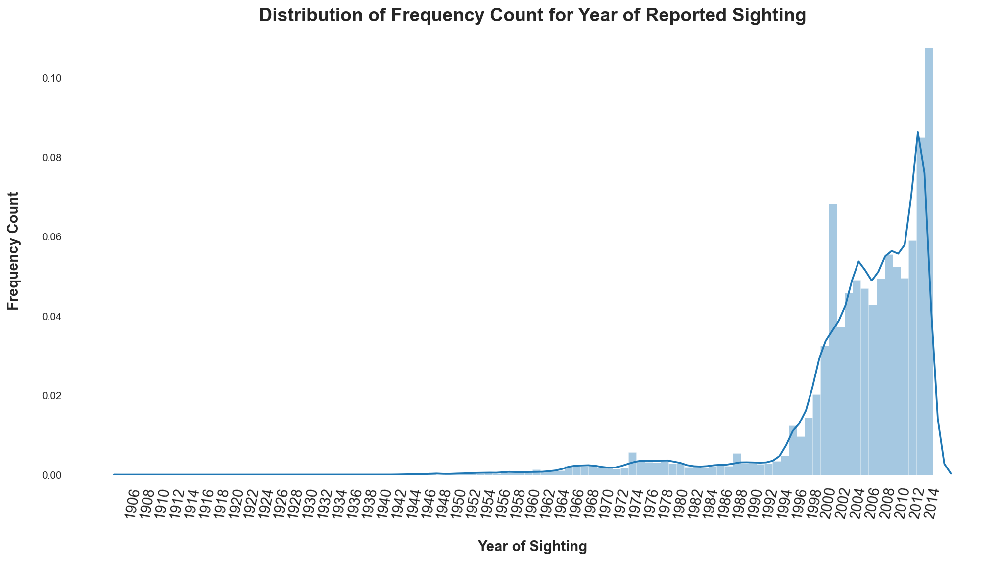

In [12]:
# Set dots per inch (DPI) to increase size of plots:
plt.rcParams['figure.dpi'] =150

# Look at a distribution plot of year:
plt.figure(figsize=(16, 8))
sns.distplot(ufos.year, bins=100)
plt.title(f'Distribution of Frequency Count for Year of Reported Sighting', size=18, weight='bold')
plt.xlabel(f'\nYear of Sighting', size=14, weight='bold')
plt.ylabel(f'Frequency Count\n', size=14, weight='bold')
plt.xticks(np.arange(1906, 2016, step=2), rotation=80, size=14);

In [13]:
# Drop all rows prior to 1993 due to lack of data:
ufos.drop(ufos[ufos['year'] <= 1993].index, inplace=True)

# Reset the index and rename old index numbers:
ufos = ufos.reset_index().rename(columns={'index':'Id'})

# Check my work:
ufos['year'].value_counts(normalize=True).sort_index(ascending=False)

2014    0.031087
2013    0.096520
2012    0.100882
2011    0.070085
2010    0.058779
2009    0.062230
2008    0.065943
2007    0.058572
2006    0.050828
2005    0.055756
2004    0.058254
2003    0.054320
2002    0.044326
2001    0.042918
2000    0.037990
1999    0.038486
1998    0.024006
1997    0.017145
1996    0.011402
1995    0.014715
1994    0.005756
Name: year, dtype: float64

In [14]:
# Look at the first 5 rows to make sure the column rename worked:
ufos.head()

,Id,datetime,city,state,country,shape,duration (seconds),duration (hours/min),comments,date posted,latitude,longitude,shape_class,dt_len,year,month,hour,dow
0,58,1994-10-10 15:00:00,mercedies,tx,NaN,cigar,3600,1 hour,ufo chased by fighter jet over Rio Grande Vall...,12/12/2011,26.149798,-97.913611,Non-Geometric,16,1994,10,15,Mon
1,59,1994-10-10 18:30:00,burnt hills,ny,us,rectangle,120,2 minutes,Giant rectangular craft (resembling an upside-...,10/23/2013,42.9097222,-73.895556,Geometric,16,1994,10,18,Mon
2,60,1994-10-10 22:00:00,pinebergen,ar,us,light,5,5 seconds,Round&#44 bright&#44 low flying object silentl...,2/18/2001,34.1027778,-91.992222,Type of Light,16,1994,10,22,Mon
3,61,1994-10-10 23:00:00,toronto (greater toronto area) (canada),on,ca,sphere,3600,~1 hour,Large rusty sphere,7/3/2013,43.666667,-79.416667,Circular,16,1994,10,23,Mon
4,62,1995-10-10 19:45:00,milwaukee,wi,us,NaN,120,2 min.,Man on Hwy 43 SW of Milwaukee sees large&#44 ...,11/2/1999,43.0388889,-87.906389,Other,16,1995,10,19,Tue


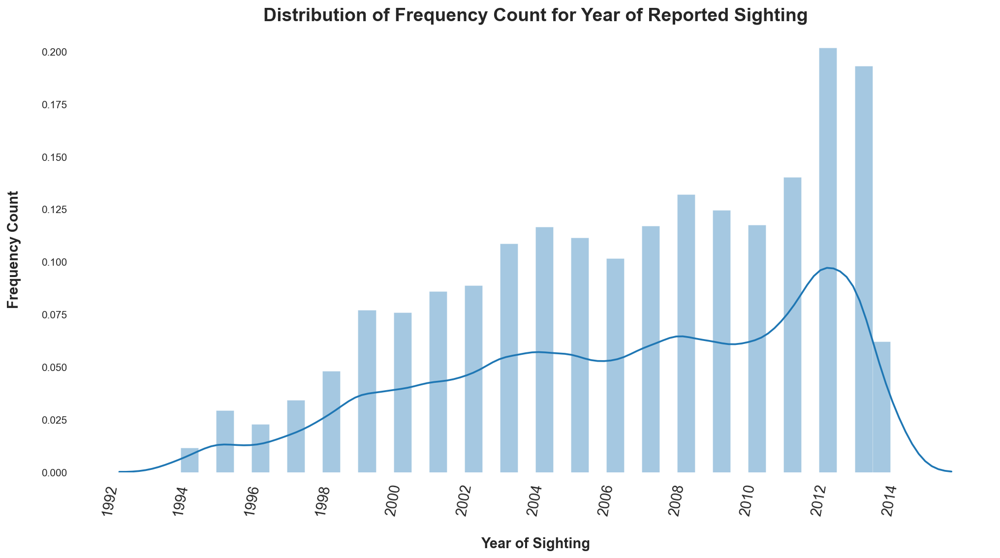

In [15]:
# Look at a distribution plot of year:
plt.figure(figsize=(16, 8))
sns.distplot(ufos.year, bins=40)
plt.title(f'Distribution of Frequency Count for Year of Reported Sighting', size=18, weight='bold')
plt.xlabel(f'\nYear of Sighting', size=14, weight='bold')
plt.ylabel(f'Frequency Count\n', size=14, weight='bold')
plt.xticks(np.arange(1992, 2016, step=2), rotation=80, size=14);

In [16]:
# Look at the shape of my new dataset with reduction in years:
ufos.shape

(72441, 18)

In [17]:
# Find out why durations in secs is not supported in the profile:
print(ufos['duration (seconds)'].dtypes)

# Look at the value counts:
ufos['duration (seconds)'].value_counts()

object


300     6218
120     5175
600     4531
60      4343
180     3755
        ... 
1244       1
235        1
0.33       1
46         1
1339       1
Name: duration (seconds), Length: 667, dtype: int64

In [18]:
# Change column names - replace spaces with underscores and removing () also: 
ufos = ufos.rename(columns={'duration (seconds)': 'durations_in_secs'})

In [19]:
# Need to replace values first that have typos:
ufos['durations_in_secs'].replace(['2`', '8`', '0.5`'], [2, 8, 0.5], inplace=True)

# Format the values to floats and all have 1 decimal place:
ufos['durations_in_secs'] = ufos['durations_in_secs'].astype(float).round(decimals=1)

# Check my work
print(ufos['durations_in_secs'].dtypes)
ufos.head(3)

float64


,Id,datetime,city,state,country,shape,durations_in_secs,duration (hours/min),comments,date posted,latitude,longitude,shape_class,dt_len,year,month,hour,dow
0,58,1994-10-10 15:00:00,mercedies,tx,NaN,cigar,3600.0,1 hour,ufo chased by fighter jet over Rio Grande Vall...,12/12/2011,26.149798,-97.913611,Non-Geometric,16,1994,10,15,Mon
1,59,1994-10-10 18:30:00,burnt hills,ny,us,rectangle,120.0,2 minutes,Giant rectangular craft (resembling an upside-...,10/23/2013,42.9097222,-73.895556,Geometric,16,1994,10,18,Mon
2,60,1994-10-10 22:00:00,pinebergen,ar,us,light,5.0,5 seconds,Round&#44 bright&#44 low flying object silentl...,2/18/2001,34.1027778,-91.992222,Type of Light,16,1994,10,22,Mon


### Handle NaN Values:

In [20]:
# Look for null values:
ufos.isnull().sum()

Id                         0
datetime                   0
city                       0
state                   5133
country                 8413
shape                   1765
durations_in_secs          0
duration (hours/min)       0
comments                  12
date posted                0
latitude                   0
longitude                  0
shape_class                0
dt_len                     0
year                       0
month                      0
hour                       0
dow                        0
dtype: int64

In [21]:
# Replace all null values with 0 for right now, then will change it back to impute the values later:
ufos = ufos.replace(np.nan, 0)

# Check my work:
ufos.isnull().sum()

Id                      0
datetime                0
city                    0
state                   0
country                 0
shape                   0
durations_in_secs       0
duration (hours/min)    0
comments                0
date posted             0
latitude                0
longitude               0
shape_class             0
dt_len                  0
year                    0
month                   0
hour                    0
dow                     0
dtype: int64

## Apply re (Real Expression) to Comments and City Features:

In [22]:
# Look at some of the comments in relation to my target:
pd.crosstab(ufos.comments, ufos.shape_class, rownames=['ufos.comments'], 
            colnames=['ufos.shape_class']).sample(20)

ufos.shape_class,Circular,Geometric,Multiple,Non-Geometric,Other,Type of Light
ufos.comments,,,,,,
Two lights with tail descends rapidly into nothingness with a burst at the end.,0,0,0,0,1,0
My wife and daughters went outside to look at the moon and she said to me &quot;there are two ufo&#39s flying over.My three year old said&#44&quot;dadd,0,0,0,0,0,1
seemed like stars travelling as if they were planes,0,0,0,0,1,0
this ligth was no plane or shooting star.,1,0,0,0,0,0
Glowing&#44 hovering object descends straight down to the ground,1,0,0,0,0,0
It was around 11:30 pm and my husband and I had walked to the edge of the ocean front walk way. We both noticed a large red glowing fi,0,0,0,0,0,1
I was standing in my driveway getting into my car when it happened. My back started to get extremly hot&#44 it felt like I was getting a,1,0,0,0,0,0
Oct 25 2013 approximately 20:30 hrs. Bright star appearing light low on the horizon (not seen in the past) observed on and off for .45,1,0,0,0,0,0
Big white shining thing crashed in the Aegean Sea between Karpathos and Rhodes,0,0,0,0,1,0


In [23]:
# Look at the number of rows in comments and city:
print('Comments', ufos.comments.shape[0])
print('City', ufos.city.shape[0])

Comments 72441
City 72441


In [24]:
# Import new libraries:
import re
import string

# Create a function to do first clean on the comments column:
def clean_text1(text):
  '''
  Remove text in [ ], punctuation, and numbers, and make text lowercase 
  '''
  text = re.sub('[^a-zA-Z]',  ' ', str(text)) # Converts all values to strings with spaces
  text = re.sub('[&#*\d]', '', text)  # Removes text in [ ]
  text = re.sub('[%s]' % re.escape(string.punctuation), '', text) # Removes punctuation
  text = text.lower()  # Makes all text lowercase
  return text

In [25]:
# Test out my function on some of the comment values:
print (clean_text1('OBJECT SPEED APPX. 70 MPH'))
print (clean_text1('Five sightings of glowing red orange fireball object over Pittsburg&#44 CA'))
print (clean_text1('Walking dog&#44 looked up&#44 saw large orange fireball with a long orange tail streak across sky directly above'))

object speed appx     mph
five sightings of glowing red orange fireball object over pittsburg     ca
walking dog     looked up     saw large orange fireball with a long orange tail streak across sky directly above


In [26]:
# Loop through all values in column:
re1 = lambda x: clean_text1(x)

# Apply to comments column in train set:
ufo_c1 = pd.DataFrame(ufos.comments.apply(re1))
ufo_c1.sample(20)

,comments
12989,red ufo
18726,diamond shaped craft from north to south c...
30433,three strange red blinking lights seen in the ...
59666,main event fast star sized object downward pa...
14388,fast moving silent black rectangle see...
23352,bright orange lights moving and hovering ove...
25382,there was a weird sound and blue flashing light
69817,tess corners lights in formation
36985,stationary bright fireball seen along the tree...
9868,observed a snow white cigar shaped object ...


In [27]:
# Import to create a document-term matrix:
from sklearn.feature_extraction.text import CountVectorizer

# Show max columns:
pd.set_option('display.max_columns', None)

# Use Count Vectorizer to create a Document Term Matrix with at least 100 value counts on train set:
cv1 = CountVectorizer(stop_words='english', min_df=100)
ufo_cv = cv1.fit_transform(ufo_c1.comments)
ufo_c = pd.DataFrame(ufo_cv.toarray(), columns=cv1.get_feature_names())

# Check my work:
print (ufo_c.shape)
ufo_c.head()

(72441, 765)


,accross,afternoon,air,aircraft,airplane,airport,alien,altitude,amazing,amber,amp,angeles,angle,apart,appear,appeared,appearing,appears,approx,approximately,april,aprox,arc,area,arizona,atmosphere,august,away,az,backyard,ball,balloon,balls,base,bay,beach,beam,beams,bedroom,began,believe,big,bigger,binoculars,bizarre,black,blinking,blue,bluish,body,boomerang,bright,brighter,brightly,brightness,brilliant,broad,brother,building,burning,ca,california,called,came,camera,canada,canadian,car,carolina,caught,center,central,change,changed,changes,changing,chased,chasing,chevron,chicago,cigar,cigarette,circle,circles,circling,circular,city,clear,clearly,close,closer,cloud,clouds,cloudy,cluster,coast,color,colorado,colored,colors,colour,come,comet,coming,commercial,completely,cone,constant,contrail,corner,corners,county,couple,course,cover,craft,crafts,cross,crossed,crossing,ct,cylinder,cylindrical,dancing,dark,darting,date,daughter,day,daylight,daytime,deck,deg,degree,degrees,denver,descending,desert,diamond,did,didn,diego,different,dim,dimmed,direction,directions,directly,disapeared,disappear,disappeared,disappearing,disappears,disc,disk,dissapeared,dissappeared,distance,distant,distinct,dog,doing,door,dot,dots,downtown,downward,driving,dropped,dropping,dull,duration,dusk,early,earth,east,eastern,edge,egg,emitted,emitting,encounter,end,england,entire,erratic,erratically,eve,evening,event,extreme,extremely,eye,eyes,facing,fade,faded,fades,fading,faint,fall,falling,falls,family,far,fast,faster,feet,fell,field,fiery,fighter,fireball,fireballs,fireworks,fl,flame,flaming,flare,flash,flashed,flashes,flashing,flat,flew,flickering,flies,flight,floated,floating,florida,fly,flying,follow,followed,following,football,form,formation,formations,formed,forming,fort,forth,freeway,friend,friends,ft,ga,georgia,getting,giant,girlfriend,gliding,glow,glowing,going,gold,golden,gone,good,got,gray,great,green,greenish,grey,ground,group,gulf,half,hanging,happened,having,haze,hbccufo,head,headed,heading,heard,helicopter,helicopters,high,highway,hill,hills,hoax,home,horizon,horizontal,horizontally,hot,hour,hours,house,houston,hover,hovered,hovering,hovers,hrs,huge,humming,husband,hwy,il,illinois,illuminated,incredible,indiana,inside,instantly,intense,interstate,island,iss,jersey,jet,jets,july,june,jupiter,just,kansas,kept,kind,know,la,lake,landing,large,larger,las,lasted,lasting,late,later,launch,leaving,left,length,level,light,lighted,lighting,lightning,lights,like,line,lines,lit,lite,little,live,local,location,long,look,looked,looking,looks,los,lot,loud,low,lower,luminous,ma,make,making,man,march,massive,maybe,metalic,metallic,meteor,mexico,mi,michigan,mid,middle,midnight,mile,miles,military,min,mins,minute,minutes,missile,missouri,mn,mo,moon,morning,mother,motion,motionless,mountain,mountains,moved,movement,movements,moves,moving,mph,mt,multi,multiple,mysterious,nc,nd,ne,near,neighborhood,neon,new,night,nights,nj,noise,non,normal,north,northeast,northern,northwest,note,notice,noticed,november,nuforc,nw,ny,obj,object,objects,observed,ocean,october,odd,ohio,old,ontario,orange,orangish,orb,orbs,oregon,outside,oval,overhead,pa,pace,parallel,park,pass,passed,passing,past,path,pattern,patterns,pd,people,perfect,perfectly,period,phoenix,phone,photo,photos,picture,pictures,pink,place,plane,planes,planet,pm,point,points,police,porch,portland,position,possible,possibly,power,probably,pulsating,pulsing,purple,quick,quickly,quiet,quite,quot,random,range,rapid,rapidly,rate,rd,real,really,reappeared,rectangle,rectangular,red,reddish,redish,reflective,report,reported,reports,repts,right,ring,rising,river,road,rocket,room,rose,rotating,round,route,row,rural,said,san,santa,sat,satellite,satellites,saucer,saw,sc,school,se,sea,seattle,sec,second,seconds,seeing,seen,sees,separate,september,series,set,sets,seven,shape,shaped,shapes,sharp,shining,shiny,ship,shoot,shooting,shoots,short,shot,shuttle,sight,sighted,sighting,sightings,silent,silently,silver,silvery,similar,single,siriu

In [28]:
# Look at the columns:
ufo_c[ufo_c.columns].head(1)

,accross,afternoon,air,aircraft,airplane,airport,alien,altitude,amazing,amber,amp,angeles,angle,apart,appear,appeared,appearing,appears,approx,approximately,april,aprox,arc,area,arizona,atmosphere,august,away,az,backyard,ball,balloon,balls,base,bay,beach,beam,beams,bedroom,began,believe,big,bigger,binoculars,bizarre,black,blinking,blue,bluish,body,boomerang,bright,brighter,brightly,brightness,brilliant,broad,brother,building,burning,ca,california,called,came,camera,canada,canadian,car,carolina,caught,center,central,change,changed,changes,changing,chased,chasing,chevron,chicago,cigar,cigarette,circle,circles,circling,circular,city,clear,clearly,close,closer,cloud,clouds,cloudy,cluster,coast,color,colorado,colored,colors,colour,come,comet,coming,commercial,completely,cone,constant,contrail,corner,corners,county,couple,course,cover,craft,crafts,cross,crossed,crossing,ct,cylinder,cylindrical,dancing,dark,darting,date,daughter,day,daylight,daytime,deck,deg,degree,degrees,denver,descending,desert,diamond,did,didn,diego,different,dim,dimmed,direction,directions,directly,disapeared,disappear,disappeared,disappearing,disappears,disc,disk,dissapeared,dissappeared,distance,distant,distinct,dog,doing,door,dot,dots,downtown,downward,driving,dropped,dropping,dull,duration,dusk,early,earth,east,eastern,edge,egg,emitted,emitting,encounter,end,england,entire,erratic,erratically,eve,evening,event,extreme,extremely,eye,eyes,facing,fade,faded,fades,fading,faint,fall,falling,falls,family,far,fast,faster,feet,fell,field,fiery,fighter,fireball,fireballs,fireworks,fl,flame,flaming,flare,flash,flashed,flashes,flashing,flat,flew,flickering,flies,flight,floated,floating,florida,fly,flying,follow,followed,following,football,form,formation,formations,formed,forming,fort,forth,freeway,friend,friends,ft,ga,georgia,getting,giant,girlfriend,gliding,glow,glowing,going,gold,golden,gone,good,got,gray,great,green,greenish,grey,ground,group,gulf,half,hanging,happened,having,haze,hbccufo,head,headed,heading,heard,helicopter,helicopters,high,highway,hill,hills,hoax,home,horizon,horizontal,horizontally,hot,hour,hours,house,houston,hover,hovered,hovering,hovers,hrs,huge,humming,husband,hwy,il,illinois,illuminated,incredible,indiana,inside,instantly,intense,interstate,island,iss,jersey,jet,jets,july,june,jupiter,just,kansas,kept,kind,know,la,lake,landing,large,larger,las,lasted,lasting,late,later,launch,leaving,left,length,level,light,lighted,lighting,lightning,lights,like,line,lines,lit,lite,little,live,local,location,long,look,looked,looking,looks,los,lot,loud,low,lower,luminous,ma,make,making,man,march,massive,maybe,metalic,metallic,meteor,mexico,mi,michigan,mid,middle,midnight,mile,miles,military,min,mins,minute,minutes,missile,missouri,mn,mo,moon,morning,mother,motion,motionless,mountain,mountains,moved,movement,movements,moves,moving,mph,mt,multi,multiple,mysterious,nc,nd,ne,near,neighborhood,neon,new,night,nights,nj,noise,non,normal,north,northeast,northern,northwest,note,notice,noticed,november,nuforc,nw,ny,obj,object,objects,observed,ocean,october,odd,ohio,old,ontario,orange,orangish,orb,orbs,oregon,outside,oval,overhead,pa,pace,parallel,park,pass,passed,passing,past,path,pattern,patterns,pd,people,perfect,perfectly,period,phoenix,phone,photo,photos,picture,pictures,pink,place,plane,planes,planet,pm,point,points,police,porch,portland,position,possible,possibly,power,probably,pulsating,pulsing,purple,quick,quickly,quiet,quite,quot,random,range,rapid,rapidly,rate,rd,real,really,reappeared,rectangle,rectangular,red,reddish,redish,reflective,report,reported,reports,repts,right,ring,rising,river,road,rocket,room,rose,rotating,round,route,row,rural,said,san,santa,sat,satellite,satellites,saucer,saw,sc,school,se,sea,seattle,sec,second,seconds,seeing,seen,sees,separate,september,series,set,sets,seven,shape,shaped,shapes,sharp,shining,shiny,ship,shoot,shooting,shoots,short,shot,shuttle,sight,sighted,sighting,sightings,silent,silently,silver,silvery,similar,single,siriu

In [29]:
# The features I will keep:
ufo_c = ufo_c[['amber', 'black', 'blue', 'bluish', 'changed', 'changing', 'clear', 'close', 'closer', 'colored', 
                   'colors', 'colour', 'dark', 'darting', 'disappear', 'disappeared', 'disappearing', 'disappears', 
                   'dissapeared', 'dissappeared', 'downward', 'dropped', 'dropping', 'dull', 'east', 'eastern', 
                   'erratic', 'erratically', 'faded', 'fall', 'falling', 'falls', 'fast', 'faster', 'fell', 'flew', 'floating', 
                   'flies', 'floated', 'floating', 'fly', 'flying', 'follow', 'followed', 'following', 'going', 'gold', 'golden', 
                   'gray', 'green', 'greenish', 'grey', 'high', 'hoax', 'horizon', 'hover', 'hovered', 'hovering', 'hovers',
                   'huge', 'humming', 'instantly', 'large', 'larger', 'long', 'low', 'lower', 'metalic', 'metallic', 'motion', 
                   'motionless', 'moved', 'movement', 'movements', 'moves', 'moving', 'neon', 'near', 'noise', 
                   'north', 'northeast', 'northern', 'northwest', 'orange', 'orangish', 'overhead', 'pulsating', 
                   'pulsing', 'purple', 'quick', 'quickly', 'quiet', 'rapid', 'rapidly', 'reappeared', 'red', 'reddish', 
                   'redish', 'reflective', 'rising', 'rose', 'rotating', 'silent', 'silently', 'silver', 'silvery', 'sitting', 
                   'slow', 'slowly', 'small', 'smaller', 'solid', 'sound', 'sounds', 'south', 'southeast', 'southern', 
                   'southwest', 'sped', 'speed', 'speeding', 'speeds', 'stationary', 'stayed', 'steady', 'stop', 'stopped', 
                   'stopping', 'stops', 'straight', 'sudden', 'suddenly', 'trail', 'traveling', 'translucent', 'transparent', 
                   'turned', 'turning', 'turns', 'upward', 'upwards', 'vanish', 'vanished', 'vanishes', 'vanishing', 
                   'west', 'western', 'white', 'yellow', 'yellowish', 'zag', 'zagging', 'zig']]

# Check my work:
print (ufo_c.shape)
ufo_c.head()

(72441, 153)


,amber,black,blue,bluish,changed,changing,clear,close,closer,colored,colors,colour,dark,darting,disappear,disappeared,disappearing,disappears,dissapeared,dissappeared,downward,dropped,dropping,dull,east,eastern,erratic,erratically,faded,fall,falling,falls,fast,faster,fell,flew,floating,flies,floated,floating,fly,flying,follow,followed,following,going,gold,golden,gray,green,greenish,grey,high,hoax,horizon,hover,hovered,hovering,hovers,huge,humming,instantly,large,larger,long,low,lower,metalic,metallic,motion,motionless,moved,movement,movements,moves,moving,neon,near,noise,north,northeast,northern,northwest,orange,orangish,overhead,pulsating,pulsing,purple,quick,quickly,quiet,rapid,rapidly,reappeared,red,reddish,redish,reflective,rising,rose,rotating,silent,silently,silver,silvery,sitting,slow,slowly,small,smaller,solid,sound,sounds,south,southeast,southern,southwest,sped,speed,speeding,speeds,stationary,stayed,steady,stop,stopped,stopping,stops,straight,sudden,suddenly,trail,traveling,translucent,transparent,turned,turning,turns,upward,upwards,vanish,vanished,vanishes,vanishing,west,western,white,yellow,yellowish,zag,zagging,zig
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [30]:
# To prevent SettingWithCopyWarning:
ufos = ufos.copy()
ufo_c = ufo_c.copy()

# Concatenate the dataframes:
ufo = pd.concat([ufos, ufo_c], axis=1)

# Check my work:
print (ufo.shape)
ufo.head(2)

(72441, 171)


,Id,datetime,city,state,country,shape,durations_in_secs,duration (hours/min),comments,date posted,latitude,longitude,shape_class,dt_len,year,month,hour,dow,amber,black,blue,bluish,changed,changing,clear,close,closer,colored,colors,colour,dark,darting,disappear,disappeared,disappearing,disappears,dissapeared,dissappeared,downward,dropped,dropping,dull,east,eastern,erratic,erratically,faded,fall,falling,falls,fast,faster,fell,flew,floating,flies,floated,floating,fly,flying,follow,followed,following,going,gold,golden,gray,green,greenish,grey,high,hoax,horizon,hover,hovered,hovering,hovers,huge,humming,instantly,large,larger,long,low,lower,metalic,metallic,motion,motionless,moved,movement,movements,moves,moving,neon,near,noise,north,northeast,northern,northwest,orange,orangish,overhead,pulsating,pulsing,purple,quick,quickly,quiet,rapid,rapidly,reappeared,red,reddish,redish,reflective,rising,rose,rotating,silent,silently,silver,silvery,sitting,slow,slowly,small,smaller,solid,sound,sounds,south,southeast,southern,southwest,sped,speed,speeding,speeds,stationary,stayed,steady,stop,stopped,stopping,stops,straight,sudden,suddenly,trail,traveling,translucent,transparent,turned,turning,turns,upward,upwards,vanish,vanished,vanishes,vanishing,west,western,white,yellow,yellowish,zag,zagging,zig
0,58,1994-10-10 15:00:00,mercedies,tx,0,cigar,3600.0,1 hour,ufo chased by fighter jet over Rio Grande Vall...,12/12/2011,26.149798,-97.913611,Non-Geometric,16,1994,10,15,Mon,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,59,1994-10-10 18:30:00,burnt hills,ny,us,rectangle,120.0,2 minutes,Giant rectangular craft (resembling an upside-...,10/23/2013,42.9097222,-73.895556,Geometric,16,1994,10,18,Mon,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [31]:
# Prevent SettingWithCopyWarning:
ufo = ufo.copy()

# Combine some features:
ufo['color'] = ufo[['amber', 'black', 'blue', 'bluish', 'changed', 'changing', 'clear', 'colored', 'colors', 'colour', 
                    'dark', 'dull', 'faded', 'gold', 'golden', 'gray', 'green', 'greenish', 'grey', 'metalic', 'metallic', 
                    'neon', 'orange', 'orangish', 'purple', 'red', 'reddish', 'redish', 'reflective', 'silver', 'silvery', 
                    'solid', 'translucent', 'transparent', 'yellow', 'yellowish']].sum(axis=1)
ufo['movement'] = ufo[['darting', 'disappear', 'disappeared', 'disappearing', 'disappears', 'dissapeared', 
                       'dissappeared', 'downward', 'dropped', 'dropping', 'east', 'eastern', 'erratic', 'erratically', 
                       'fast', 'flew', 'floating', 'flies', 'floated', 'floating', 'fly', 'flying', 'follow', 'followed', 'following', 
                       'going', 'hover', 'hovered', 'hovering', 'hovers', 'instantly', 'motion', 'motionless', 'moved', 
                       'movement', 'movements', 'moves', 'moving', 'north', 'northeast', 'northern', 'northwest', 
                       'straight', 'quick', 'quickly', 'rapid', 'rapidly', 'reappeared', 'rising', 'rose', 'rotating', 'sitting', 
                       'slow', 'slowly', 'south', 'southeast', 'southern', 'southwest', 'sped', 'speed', 'speeding', 
                       'speeds', 'stationary', 'stayed', 'steady', 'stop', 'stopped', 'stops', 'straight', 'sudden', 
                       'suddenly', 'trail', 'traveling', 'turned', 'turning', 'turns', 'upward', 'upwards', 'vanish', 
                       'vanished', 'vanishes', 'vanishing', 'west', 'western', 'zag', 'zagging', 'zig']].sum(axis=1)
ufo['elevation'] = ufo[['close', 'closer', 'fall', 'falling', 'falls', 'high', 'horizon', 'low', 'lower', 'near', 
                        'overhead']].sum(axis=1)
ufo['sound'] = ufo[['humming', 'noise', 'pulsating', 'pulsing', 'quiet', 'silent', 'silently', 'sound', 
                    'sounds']].sum(axis=1)

# Drop some columns:large	larger	long	small	smaller	
ufo = ufo.drop(columns=['datetime', 'shape', 'duration (hours/min)', 'comments', 'date posted', 'dt_len', 
                        'amber', 'black', 'blue', 'bluish', 'changed', 'changing', 'clear', 'close', 'closer', 'colored', 
                        'colors', 'colour', 'dark', 'darting', 'disappear', 'disappeared', 'disappearing', 'disappears', 
                        'dissapeared', 'dissappeared', 'downward', 'dropped', 'dropping', 'dull', 'east', 'eastern', 
                        'erratic', 'erratically', 'faded', 'fall', 'falling', 'falls', 'fast', 'faster', 'fell', 'flew', 'floating', 
                        'flies', 'floated', 'floating', 'fly', 'flying', 'follow', 'followed', 'following', 'going', 'gold', 
                        'golden', 'gray', 'green', 'greenish', 'grey', 'high', 'horizon', 'hover', 'hovered', 'hovering', 
                        'hovers', 'huge', 'humming', 'instantly', 'large', 'larger', 'long', 'low', 'lower', 'metalic', 
                        'metallic', 'motion', 'motionless', 'moved', 'movements', 'moves', 'moving', 'neon', 'near', 
                        'noise', 'north', 'northeast', 'northern', 'northwest', 'orange', 'orangish', 'overhead', 
                        'pulsating', 'pulsing', 'purple', 'quick', 'quickly', 'quiet', 'rapid', 'rapidly', 'reappeared', 
                        'red', 'reddish', 'redish', 'reflective', 'rising', 'rose', 'rotating', 'silent', 'silently', 'silver', 
                        'silvery', 'sitting', 'slow', 'slowly', 'small', 'smaller', 'solid', 'sounds', 'south', 'southeast', 
                        'southern', 'southwest', 'sped', 'speed', 'speeding', 'speeds', 'stationary', 'stayed', 'steady', 
                        'stop', 'stopped', 'stopping', 'stops', 'straight', 'sudden', 'suddenly', 'trail', 'traveling', 
                        'translucent', 'transparent', 'turned', 'turning', 'turns', 'upward', 'upwards', 'vanish', 
                        'vanished', 'vanishes', 'vanishing', 'west', 'western', 'white', 'yellow', 'yellowish', 'zag', 
                        'zagging', 'zig'])

# Turn features from comment feature into binary:
ufo.loc[(ufo['color'] != 0), 'color'] = 1
ufo.loc[(ufo['sound'] != 0), 'sound'] = 1
ufo.loc[(ufo['movement'] != 0), 'movement'] = 1
ufo.loc[(ufo['elevation'] != 0), 'elevation'] = 1
ufo.loc[(ufo['hoax'] != 0), 'hoax'] = 1

# Rearrange features:
ufo = ufo[['Id', 'year', 'month', 'dow', 'hour', 'durations_in_secs', 'city', 'state', 'country', 'latitude', 
           'longitude', 'color', 'movement', 'elevation', 'sound', 'hoax', 'shape_class']]

# Check my work:
print(ufo.shape)
ufo.head(3)

(72441, 17)


,Id,year,month,dow,hour,durations_in_secs,city,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58,1994,10,Mon,15,3600.0,mercedies,tx,0,26.149798,-97.913611,0,0,0,0,0,Non-Geometric
1,59,1994,10,Mon,18,120.0,burnt hills,ny,us,42.9097222,-73.895556,0,0,1,0,0,Geometric
2,60,1994,10,Mon,22,5.0,pinebergen,ar,us,34.1027778,-91.992222,0,1,1,1,0,Type of Light


In [32]:
# Need to split the city column because the country is listed in some of them:
city_split = ufo.city.str.split(' ', expand=True)

# Check my work:
city_split.head(10)

,0,1,2,3,4,5,6,7,8,9,10,11
0,mercedies,None,None,None,None,None,None,None,None,None,None,None
1,burnt,hills,None,None,None,None,None,None,None,None,None,None
2,pinebergen,None,None,None,None,None,None,None,None,None,None,None
3,toronto,(greater,toronto,area),(canada),None,None,None,None,None,None,None
4,milwaukee,None,None,None,None,None,None,None,None,None,None,None
5,oakland,None,None,None,None,None,None,None,None,None,None,None
6,higginsville,None,None,None,None,None,None,None,None,None,None,None
7,lake,macquarie,(nsw&#44,australia),None,None,None,None,None,None,None,None
8,charleston,None,None,None,None,None,None,None,None,None,None,None
9,monroe,county,None,None,None,None,None,None,None,None,None,None


In [33]:
# Look at the value counts for each column:
for col in city_split:
    print(f'{col}\n', city_split[col].value_counts(), '\n')

0
 san             1248
new              913
st.              601
seattle          546
north            531
                ... 
bruceton           1
wintersville       1
putman             1
miltona            1
zwolle             1
Name: 0, Length: 11297, dtype: int64 

1
 (canada)         2479
(uk/england)     1372
city             1311
beach            1094
park              602
                 ... 
bethel/pa-nj        1
bonifacio           1
virgin              1
manhattan           1
(inflight&#44       1
Name: 1, Length: 3154, dtype: int64 

2
 city             676
(canada)         605
(uk/england)     291
beach            267
of)              215
                ... 
ottawa)            1
jamaican           1
(camp              1
terrace            1
(westminster)      1
Name: 2, Length: 1637, dtype: int64 

3
 (brooklyn)         126
of)                109
(uk/england)       101
(canada)           101
miles               66
                  ... 
&#39emrohit&#39      1
ireland 

In [34]:
# To prevent SettingWithCopyWarning:
ufo = ufo.copy()
city_split = city_split.copy()

# Drop column 11 first, no useful information:
city_split.drop(columns=11, inplace=True)

# Concatenate the dataframes:
ufo = pd.concat([ufo, city_split], axis=1)

# Check my work:
print (ufo.shape)
ufo.head(10)

(72441, 28)


,Id,year,month,dow,hour,durations_in_secs,city,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class,0,1,2,3,4,5,6,7,8,9,10
0,58,1994,10,Mon,15,3600.0,mercedies,tx,0,26.149798,-97.913611,0,0,0,0,0,Non-Geometric,mercedies,None,None,None,None,None,None,None,None,None,None
1,59,1994,10,Mon,18,120.0,burnt hills,ny,us,42.9097222,-73.895556,0,0,1,0,0,Geometric,burnt,hills,None,None,None,None,None,None,None,None,None
2,60,1994,10,Mon,22,5.0,pinebergen,ar,us,34.1027778,-91.992222,0,1,1,1,0,Type of Light,pinebergen,None,None,None,None,None,None,None,None,None,None
3,61,1994,10,Mon,23,3600.0,toronto (greater toronto area) (canada),on,ca,43.666667,-79.416667,0,0,0,0,0,Circular,toronto,(greater,toronto,area),(canada),None,None,None,None,None,None
4,62,1995,10,Tue,19,120.0,milwaukee,wi,us,43.0388889,-87.906389,1,0,0,0,0,Other,milwaukee,None,None,None,None,None,None,None,None,None,None
5,63,1995,10,Tue,22,60.0,oakland,ca,us,37.8044444,-122.269722,0,1,1,0,0,Other,oakland,None,None,None,None,None,None,None,None,None,None
6,64,1996,10,Thr,3,3.0,higginsville,mo,us,39.0725,-93.716944,0,1,1,0,0,Geometric,higginsville,None,None,None,None,None,None,None,None,None,None
7,65,1996,10,Thr,20,300.0,lake macquarie (nsw&#44 australia),0,0,-33.093373,151.588982,1,0,0,0,0,Type of Light,lake,macquarie,(nsw&#44,australia),None,None,None,None,None,None,None
8,66,1996,10,Thr,22,300.0,charleston,sc,us,32.7763889,-79.931111,0,0,0,0,0,Type of Light,charleston,None,None,None,None,None,None,None,None,None,None
9,67,1996,10,Thr,22,60.0,monroe county,oh,us,39.4402778,-84.362222,0,0,0,0,0,Non-Geometric,monroe,county,None,None,None,None,None,None,None,None,None


In [35]:
# Rearrange the features:
ufo = ufo[['Id', 'year', 'month', 'dow', 'hour', 'durations_in_secs', 'city', 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 'state', 
           'country', 'latitude', 'longitude', 'color', 'movement', 'elevation', 'sound', 'hoax', 'shape_class']]

# Check my work:
ufo.head()

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,10,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58,1994,10,Mon,15,3600.0,mercedies,mercedies,None,None,None,None,None,None,None,None,None,None,tx,0,26.149798,-97.913611,0,0,0,0,0,Non-Geometric
1,59,1994,10,Mon,18,120.0,burnt hills,burnt,hills,None,None,None,None,None,None,None,None,None,ny,us,42.9097222,-73.895556,0,0,1,0,0,Geometric
2,60,1994,10,Mon,22,5.0,pinebergen,pinebergen,None,None,None,None,None,None,None,None,None,None,ar,us,34.1027778,-91.992222,0,1,1,1,0,Type of Light
3,61,1994,10,Mon,23,3600.0,toronto (greater toronto area) (canada),toronto,(greater,toronto,area),(canada),None,None,None,None,None,None,on,ca,43.666667,-79.416667,0,0,0,0,0,Circular
4,62,1995,10,Tue,19,120.0,milwaukee,milwaukee,None,None,None,None,None,None,None,None,None,None,wi,us,43.0388889,-87.906389,1,0,0,0,0,Other


### Locations:

In [36]:
# There is a mistype in one of the latitude values causing it to be an object data type.
# Need to remove the letter in the problem value:
ufo['latitude'] = ufo['latitude'].replace('33q.200088', '33.200088')

# Convert latitue to a float now that I replaced the problem value:
ufo['latitude'] = ufo['latitude'].astype(float)

# Check my work by checking the data type now:
ufo['latitude'].dtypes

dtype('float64')

In [37]:
# Capitalize first letter of each word in city:
ufo['city'] = ufo['city'].str.title()

# Capitalize state abbreviations:
ufo['state'] = ufo['state'].str.upper()

# Check my work:
ufo.head()

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,10,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58,1994,10,Mon,15,3600.0,Mercedies,mercedies,None,None,None,None,None,None,None,None,None,None,TX,0,26.149798,-97.913611,0,0,0,0,0,Non-Geometric
1,59,1994,10,Mon,18,120.0,Burnt Hills,burnt,hills,None,None,None,None,None,None,None,None,None,NY,us,42.909722,-73.895556,0,0,1,0,0,Geometric
2,60,1994,10,Mon,22,5.0,Pinebergen,pinebergen,None,None,None,None,None,None,None,None,None,None,AR,us,34.102778,-91.992222,0,1,1,1,0,Type of Light
3,61,1994,10,Mon,23,3600.0,Toronto (Greater Toronto Area) (Canada),toronto,(greater,toronto,area),(canada),None,None,None,None,None,None,ON,ca,43.666667,-79.416667,0,0,0,0,0,Circular
4,62,1995,10,Tue,19,120.0,Milwaukee,milwaukee,None,None,None,None,None,None,None,None,None,None,WI,us,43.038889,-87.906389,1,0,0,0,0,Other


In [38]:
# Change country values to names:
ufo['country'] = ufo['country'].replace(['us', 'ca', 'gb', 'au', 'de'], ['USA', 'Canada', 'UK', 
                                                                           'Australia', 'Germany'])

# Check my work:
ufo.country.value_counts()

USA          58983
0             8413
Canada        2745
UK            1733
Australia      483
Germany         84
Name: country, dtype: int64

In [39]:
# Replace None with 0:
ufo = ufo.replace(np.nan, 0)

# Check my work:
ufo.head()

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,10,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58,1994,10,Mon,15,3600.0,Mercedies,mercedies,0,0,0,0,0,0,0,0,0,0,TX,0,26.149798,-97.913611,0,0,0,0,0,Non-Geometric
1,59,1994,10,Mon,18,120.0,Burnt Hills,burnt,hills,0,0,0,0,0,0,0,0,0,NY,USA,42.909722,-73.895556,0,0,1,0,0,Geometric
2,60,1994,10,Mon,22,5.0,Pinebergen,pinebergen,0,0,0,0,0,0,0,0,0,0,AR,USA,34.102778,-91.992222,0,1,1,1,0,Type of Light
3,61,1994,10,Mon,23,3600.0,Toronto (Greater Toronto Area) (Canada),toronto,(greater,toronto,area),(canada),0,0,0,0,0,0,ON,Canada,43.666667,-79.416667,0,0,0,0,0,Circular
4,62,1995,10,Tue,19,120.0,Milwaukee,milwaukee,0,0,0,0,0,0,0,0,0,0,WI,USA,43.038889,-87.906389,1,0,0,0,0,Other


In [40]:
# Look at all the rows where country is 0:
ufo[ufo['country'] == 0]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,10,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58,1994,10,Mon,15,3600.0,Mercedies,mercedies,0,0,0,0,0,0,0,0,0,0,TX,0,26.149798,-97.913611,0,0,0,0,0,Non-Geometric
7,65,1996,10,Thr,20,300.0,Lake Macquarie (Nsw&#44 Australia),lake,macquarie,(nsw&#44,australia),0,0,0,0,0,0,0,0,0,-33.093373,151.588982,1,0,0,0,0,Type of Light
19,77,1998,10,Sat,20,60.0,Nyc/Westchester Area,nyc/westchester,area,0,0,0,0,0,0,0,0,0,NY,0,40.935998,-73.901708,0,0,0,0,0,Geometric
32,90,1999,10,Sun,22,120.0,Casey Key (North End Of),casey,key,(north,end,of),0,0,0,0,0,0,FL,0,27.150053,-82.480653,0,1,1,0,0,Geometric
38,96,2000,10,Tue,16,45.0,Jueanu,jueanu,0,0,0,0,0,0,0,0,0,0,WI,0,43.405550,-88.705104,0,0,0,0,0,Geometric
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72347,80238,2009,9,Wed,14,120.0,Broomfield?Lafayette,broomfield?lafayette,0,0,0,0,0,0,0,0,0,0,CO,0,39.993596,-105.089706,0,1,0,0,0,Geometric
72353,80244,2009,9,Wed,20,600.0,Lyman,lyman,0,0,0,0,0,0,0,0,0,0,ME,0,43.505096,-70.637968,0,1,0,0,0,Type of Light
72428,80319,2013,9,Mon,20,3600.0,Clifton,clifton,0,0,0,0,0,0,0,0,0,0,NJ,0,40.858433,-74.163755,0,0,0,0,0,Other
72431,80322,2013,9,Mon,21,15.0,Aleksandrow (Poland),aleksandrow,(poland),0,0,0,0,0,0,0,0,0,0,0,50.465843,22.891814,0,1,0,0,0,Type of Light


In [41]:
# Seems that most of the countries where a state is listed is in the US:
# Look at those first:
states = ufo[(ufo['country'] == 0) & (ufo['state'] != 0)]
print (states.shape)
states

(5576, 28)


,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,10,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58,1994,10,Mon,15,3600.0,Mercedies,mercedies,0,0,0,0,0,0,0,0,0,0,TX,0,26.149798,-97.913611,0,0,0,0,0,Non-Geometric
19,77,1998,10,Sat,20,60.0,Nyc/Westchester Area,nyc/westchester,area,0,0,0,0,0,0,0,0,0,NY,0,40.935998,-73.901708,0,0,0,0,0,Geometric
32,90,1999,10,Sun,22,120.0,Casey Key (North End Of),casey,key,(north,end,of),0,0,0,0,0,0,FL,0,27.150053,-82.480653,0,1,1,0,0,Geometric
38,96,2000,10,Tue,16,45.0,Jueanu,jueanu,0,0,0,0,0,0,0,0,0,0,WI,0,43.405550,-88.705104,0,0,0,0,0,Geometric
39,97,2000,10,Tue,20,15.0,Valley Park Area Of St. Louis,valley,park,area,of,st.,louis,0,0,0,0,0,MO,0,38.627003,-90.199404,0,1,0,0,0,Circular
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72314,80205,2005,9,Fri,21,10.0,Gold Canyon,gold,canyon,0,0,0,0,0,0,0,0,0,AZ,0,33.359341,-111.450030,1,1,0,0,0,Other
72347,80238,2009,9,Wed,14,120.0,Broomfield?Lafayette,broomfield?lafayette,0,0,0,0,0,0,0,0,0,0,CO,0,39.993596,-105.089706,0,1,0,0,0,Geometric
72353,80244,2009,9,Wed,20,600.0,Lyman,lyman,0,0,0,0,0,0,0,0,0,0,ME,0,43.505096,-70.637968,0,1,0,0,0,Type of Light
72428,80319,2013,9,Mon,20,3600.0,Clifton,clifton,0,0,0,0,0,0,0,0,0,0,NJ,0,40.858433,-74.163755,0,0,0,0,0,Other


In [42]:
# Change all values in coutry where state == val:
ufo.loc[(ufo['state'] == 'AK') & (ufo['country'] == 'USA'), 'country'] = 'Alaska'
ufo.loc[(ufo['state'] == 'AK') & (ufo['country'] == 0), 'country'] = 'Alaska'
ufo.loc[(ufo['state'] == 'HI') & (ufo['country'] == 'USA'), 'country'] = 'Hawaii'
ufo.loc[(ufo['state'] == 'HI') & (ufo['country'] == 0), 'country'] = 'Hawaii'
ufo.loc[(ufo['state'] == 'BC') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'NF') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'ON') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'AB') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'PE') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'PQ') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'MB') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'QC') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'NT') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'SK') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'NS') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'NB') & (ufo['country'] == 0), 'country'] = 'Canada'
ufo.loc[(ufo['state'] == 'PR') & (ufo['country'] == 0), 'country'] = 'Puerto Rico'

# Check my work:
ufo['country'].value_counts(sort=False)

0               7775
Germany           84
Hawaii           314
Puerto Rico        3
Australia        483
Alaska           300
UK              1733
USA            58474
Canada          3275
Name: country, dtype: int64

In [43]:
# Look at all country rows with 0 and 10 is not 0:
ufo[(ufo[10] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

# Drop column 10, no useful information:
ufo = ufo.drop(columns=10)

# Check my work:
ufo.head(2)

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
0,58,1994,10,Mon,15,3600.0,Mercedies,mercedies,0,0,0,0,0,0,0,0,0,TX,0,26.149798,-97.913611,0,0,0,0,0,Non-Geometric
1,59,1994,10,Mon,18,120.0,Burnt Hills,burnt,hills,0,0,0,0,0,0,0,0,NY,USA,42.909722,-73.895556,0,0,1,0,0,Geometric


In [44]:
# Look at all country rows with 0 and 9 is not 0:
ufo[(ufo[9] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
49529,54650,1997,7,Thr,16,7.0,Vergel De La Sierra (Mountain Name; Near No Ci...,vergel,de,la,sierra,(mountain,name;,near,no,city),(mexico),0,0,23.736159,-99.178294,1,0,0,0,0,Geometric
67032,74670,1994,9,Thr,10,900.0,Mexicali B. C. Mexico; Sierra Cucapah; Cerro P...,mexicali,b.,c.,mexico;,sierra,cucapah;,cerro,prieto.&#44,b.,c.,0,0,30.889354,-108.188584,1,1,0,0,0,Circular
68008,75677,1996,9,Thr,23,420.0,Paris / Arc De Triomph (2 Furlongs From It (Fr...,paris,/,arc,de,triomph,(2,furlongs,from,it,(france),0,0,48.856614,2.352222,0,1,0,0,0,Circular


In [44]:
# # Show all rows:
# pd.set_option('display.max_rows', None)

# Look at all country rows with 0 and 8 is not 0:
ufo[(ufo[8] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
21492,23143,2000,12,Thr,8,300.0,In-Flight (Over The North Sea&#44 Between Engl...,in-flight,(over,the,north,sea&#44,between,england,&amp;,denmark),0,0,0,38.584329,-108.073096,0,0,0,0,0,Non-Geometric
31811,34017,2005,3,Tue,17,120.0,Sharourah (500 Km North Of) (Empty Quarter) (S...,sharourah,(500,km,north,of),(empty,quarter),(saudi,arabia),0,0,0,17.483333,47.116667,0,1,1,0,0,Type of Light
33773,36115,2004,4,Thr,2,1380.0,Puerto De San Jose (Near&#44 In Ocean) (Guata...,puerto,de,san,jose,,(near&#44,in,ocean),(guatamala),0,0,0,13.933333,-90.816667,0,1,0,0,0,Other
40044,42966,1999,5,Tue,1,30.0,Atlantic Ocean (Between San Juan And U.S. Virg...,atlantic,ocean,(between,san,juan,and,u.s.,virgin,isl.),0,0,0,-14.599413,-28.673147,0,1,0,0,0,Type of Light
49529,54650,1997,7,Thr,16,7.0,Vergel De La Sierra (Mountain Name; Near No Ci...,vergel,de,la,sierra,(mountain,name;,near,no,city),(mexico),0,0,23.736159,-99.178294,1,0,0,0,0,Geometric
52203,58053,2005,7,Tue,22,0.4,Tempesque Bridge (West Of Palma Approach To) (...,tempesque,bridge,(west,of,palma,approach,to),(costa,rica),0,0,0,9.920987,-84.098549,0,1,1,0,0,Other
65043,72310,1996,8,Thr,3,2.0,Cuenca (Eof&#44 In The High Andes Mts) (Ecuador),cuenca,(eof&#44,in,the,high,andes,mts),,(ecuador),0,0,0,40.070393,-2.137416,0,1,1,0,0,Type of Light
67032,74670,1994,9,Thr,10,900.0,Mexicali B. C. Mexico; Sierra Cucapah; Cerro P...,mexicali,b.,c.,mexico;,sierra,cucapah;,cerro,prieto.&#44,b.,c.,0,0,30.889354,-108.188584,1,1,0,0,0,Circular
68008,75677,1996,9,Thr,23,420.0,Paris / Arc De Triomph (2 Furlongs From It (Fr...,paris,/,arc,de,triomph,(2,furlongs,from,it,(france),0,0,48.856614,2.352222,0,1,0,0,0,Circular


In [45]:
# Look at all country rows with 0 and 7 is not 0:
ufo[(ufo[7] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
21492,23143,2000,12,Thr,8,300.0,In-Flight (Over The North Sea&#44 Between Engl...,in-flight,(over,the,north,sea&#44,between,england,&amp;,denmark),0,0,0,38.584329,-108.073096,0,0,0,0,0,Non-Geometric
31811,34017,2005,3,Tue,17,120.0,Sharourah (500 Km North Of) (Empty Quarter) (S...,sharourah,(500,km,north,of),(empty,quarter),(saudi,arabia),0,0,0,17.483333,47.116667,0,1,1,0,0,Type of Light
33773,36115,2004,4,Thr,2,1380.0,Puerto De San Jose (Near&#44 In Ocean) (Guata...,puerto,de,san,jose,,(near&#44,in,ocean),(guatamala),0,0,0,13.933333,-90.816667,0,1,0,0,0,Other
35473,37976,2008,4,Sun,19,3.0,Pacific Ocean (In-Flight; From Tokyo Airport T...,pacific,ocean,(in-flight;,from,tokyo,airport,to,honolulu),0,0,0,0,-8.783195,-124.508523,0,1,0,0,0,Type of Light
40044,42966,1999,5,Tue,1,30.0,Atlantic Ocean (Between San Juan And U.S. Virg...,atlantic,ocean,(between,san,juan,and,u.s.,virgin,isl.),0,0,0,-14.599413,-28.673147,0,1,0,0,0,Type of Light
49529,54650,1997,7,Thr,16,7.0,Vergel De La Sierra (Mountain Name; Near No Ci...,vergel,de,la,sierra,(mountain,name;,near,no,city),(mexico),0,0,23.736159,-99.178294,1,0,0,0,0,Geometric
50044,55406,1999,7,Thr,23,600.0,Xangrila (In Rio G Do Sul State) (Brazil),xangrila,(in,rio,g,do,sul,state),(brazil),0,0,0,0,-29.802776,-50.041263,0,0,0,0,0,Geometric
52203,58053,2005,7,Tue,22,0.4,Tempesque Bridge (West Of Palma Approach To) (...,tempesque,bridge,(west,of,palma,approach,to),(costa,rica),0,0,0,9.920987,-84.098549,0,1,1,0,0,Other
52407,58335,2004,7,Tue,1,600.0,Cancun (Playa Del Carmen) (2 Hours South Of),cancun,(playa,del,carmen),(2,hours,south,of),0,0,0,0,21.161908,-86.851528,0,0,0,0,0,Type of Light
65043,72310,1996,8,Thr,3,2.0,Cuenca (Eof&#44 In The High Andes Mts) (Ecuador),cuenca,(eof&#44,in,the,high,andes,mts),,(ecuador),0,0,0,40.070393,-2.137416,0,1,1,0,0,Type of Light


In [46]:
# Look at all country rows with 0 and 6 is not 0:
ufo[(ufo[6] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
1485,1905,1994,10,Sat,22,120.0,Bry Sur Marne (Near Paris) (France),bry,sur,marne,,(near,paris),(france),0,0,0,0,0,48.834913,2.523649,1,0,0,0,0,Other
1576,1999,2000,10,Sun,1,45.0,Los Americas (Laguna Park 1 Hotel) (Tenerife),los,americas,(laguna,park,1,hotel),(tenerife),0,0,0,0,0,4.525720,-75.697600,0,1,0,0,0,Circular
3885,4447,1995,10,Wed,22,3.0,Sandals Royal Jamaican Resort&#44 Montego Bay ...,sandals,royal,jamaican,resort&#44,montego,bay,(jamaica),0,0,0,0,0,18.466667,-77.916667,1,1,0,1,0,Geometric
8325,9187,2008,11,Fri,19,10.0,Aland Islands (Forty Miles South Of) (Finland),aland,islands,(forty,miles,south,of),(finland),0,0,0,0,0,60.178525,19.915610,0,1,0,0,0,Type of Light
16173,17582,2012,1,Sat,3,600.0,El Tanque De La Fortuna (Costa Rica),el,tanque,de,la,fortuna,(costa,rica),0,0,0,0,0,10.477465,-84.580681,1,0,1,0,0,Other
18496,20033,2007,12,Sun,4,3600.0,San Jose Del Cabo (Baja California) (Mexico),san,jose,del,cabo,(baja,california),(mexico),0,0,0,0,0,23.063656,-109.702438,0,1,1,0,0,Other
19800,21394,2012,12,Sun,19,600.0,Suwon (30 Miles South Of) (South Korea),suwon,(30,miles,south,of),(south,korea),0,0,0,0,0,37.263573,127.028601,0,1,0,0,0,Type of Light
20577,22202,2002,12,Wed,1,600.0,Monterrey (Mexico) (Outside City&#44 On Large ...,monterrey,(mexico),(outside,city&#44,on,large,highway),0,0,0,0,0,25.686614,-100.316113,0,0,0,0,0,Other
21260,22908,2003,1,Sun,19,30.0,Dun Laoghaire (County Dublin (Republic Of Irel...,dun,laoghaire,(county,dublin,(republic,of,ireland),0,0,0,0,0,53.292790,-6.141937,1,1,0,0,0,Type of Light
21492,23143,2000,12,Thr,8,300.0,In-Flight (Over The North Sea&#44 Between Engl...,in-flight,(over,the,north,sea&#44,between,england,&amp;,denmark),0,0,0,38.584329,-108.073096,0,0,0,0,0,Non-Geometric


In [47]:
# Look at all country rows with 0 and 5 is not 0:
ufo[(ufo[5] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
821,1028,2000,10,Thr,11,7620.0,La Serena (Vi&Ntilde;A Del Mar) (Chile),la,serena,(vi&ntilde;a,del,mar),(chile),0,0,0,0,0,0,-29.906301,-71.250204,0,0,1,0,0,Multiple
1270,1496,1998,10,Wed,1,300.0,South Eastern Coast (Republic Of Ireland),south,eastern,coast,(republic,of,ireland),0,0,0,0,0,0,22.564254,114.229432,0,1,1,0,0,Geometric
1485,1905,1994,10,Sat,22,120.0,Bry Sur Marne (Near Paris) (France),bry,sur,marne,,(near,paris),(france),0,0,0,0,0,48.834913,2.523649,1,0,0,0,0,Other
1576,1999,2000,10,Sun,1,45.0,Los Americas (Laguna Park 1 Hotel) (Tenerife),los,americas,(laguna,park,1,hotel),(tenerife),0,0,0,0,0,4.525720,-75.697600,0,1,0,0,0,Circular
3885,4447,1995,10,Wed,22,3.0,Sandals Royal Jamaican Resort&#44 Montego Bay ...,sandals,royal,jamaican,resort&#44,montego,bay,(jamaica),0,0,0,0,0,18.466667,-77.916667,1,1,0,1,0,Geometric
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69469,77224,2007,9,Sun,20,240.0,Llangollen &Amp; Wrexham (Uk/ North Wales),llangollen,&amp;,wrexham,(uk/,north,wales),0,0,0,0,0,0,52.931656,-3.056637,1,0,0,0,0,Type of Light
70018,77790,2003,9,Fri,21,5.0,Blackburn&#44 Lancashire (30 Mi. Nw Of Manches...,blackburn&#44,lancashire,(30,mi.,nw,of,manchester),(uk/england),0,0,0,0,53.748575,-2.487529,0,1,0,0,0,Other
71033,78861,2001,9,Mon,0,300.0,Taif (30 Km West From) (Saudi Arabia),taif,(30,km,west,from),(saudi,arabia),0,0,0,0,0,21.266667,40.416667,0,0,0,0,0,Other
72008,79885,1996,9,Sun,0,10800.0,Seattle To Tokyo (2 Nwa Flt 007),seattle,to,tokyo,(2,nwa,flt,007),0,0,0,0,0,47.606210,-122.332071,0,1,0,0,0,Circular


In [48]:
# Look at all country rows with 0 and 4 is not 0:
ufo[(ufo[4] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
821,1028,2000,10,Thr,11,7620.0,La Serena (Vi&Ntilde;A Del Mar) (Chile),la,serena,(vi&ntilde;a,del,mar),(chile),0,0,0,0,0,0,-29.906301,-71.250204,0,0,1,0,0,Multiple
1270,1496,1998,10,Wed,1,300.0,South Eastern Coast (Republic Of Ireland),south,eastern,coast,(republic,of,ireland),0,0,0,0,0,0,22.564254,114.229432,0,1,1,0,0,Geometric
1323,1549,2002,10,Mon,19,300.0,Cagayan De Oro City (Philippines),cagayan,de,oro,city,(philippines),0,0,0,0,0,0,0,8.454236,124.631898,0,0,0,0,0,Circular
1485,1905,1994,10,Sat,22,120.0,Bry Sur Marne (Near Paris) (France),bry,sur,marne,,(near,paris),(france),0,0,0,0,0,48.834913,2.523649,1,0,0,0,0,Other
1576,1999,2000,10,Sun,1,45.0,Los Americas (Laguna Park 1 Hotel) (Tenerife),los,americas,(laguna,park,1,hotel),(tenerife),0,0,0,0,0,4.525720,-75.697600,0,1,0,0,0,Circular
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70018,77790,2003,9,Fri,21,5.0,Blackburn&#44 Lancashire (30 Mi. Nw Of Manches...,blackburn&#44,lancashire,(30,mi.,nw,of,manchester),(uk/england),0,0,0,0,53.748575,-2.487529,0,1,0,0,0,Other
70433,78221,2006,9,Thr,20,30.0,Winter Hill (Near Bolton)) (Uk/England),winter,hill,(near,bolton)),(uk/england),0,0,0,0,0,0,0,42.390801,-71.095831,1,1,1,0,0,Geometric
71033,78861,2001,9,Mon,0,300.0,Taif (30 Km West From) (Saudi Arabia),taif,(30,km,west,from),(saudi,arabia),0,0,0,0,0,21.266667,40.416667,0,0,0,0,0,Other
72008,79885,1996,9,Sun,0,10800.0,Seattle To Tokyo (2 Nwa Flt 007),seattle,to,tokyo,(2,nwa,flt,007),0,0,0,0,0,47.606210,-122.332071,0,1,0,0,0,Circular


In [49]:
# Look at all country rows with 0 and 3 is not 0:
ufo[(ufo[3] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
7,65,1996,10,Thr,20,300.0,Lake Macquarie (Nsw&#44 Australia),lake,macquarie,(nsw&#44,australia),0,0,0,0,0,0,0,0,-33.093373,151.588982,1,0,0,0,0,Type of Light
67,125,2003,10,Fri,23,2700.0,Bickerton (Near Wetherby) (Uk/England),bickerton,(near,wetherby),(uk/england),0,0,0,0,0,0,0,0,53.070884,-2.736506,1,1,0,0,0,Other
738,930,2011,10,Sat,17,180.0,Carrieres Sous Poissy (France),carrieres,sous,poissy,(france),0,0,0,0,0,0,0,0,48.945484,2.037356,1,1,1,1,0,Non-Geometric
821,1028,2000,10,Thr,11,7620.0,La Serena (Vi&Ntilde;A Del Mar) (Chile),la,serena,(vi&ntilde;a,del,mar),(chile),0,0,0,0,0,0,-29.906301,-71.250204,0,0,1,0,0,Multiple
835,1042,2001,10,Fri,19,2.0,Sainte-Suzanne (Near Switzerland) (France),sainte-suzanne,(near,switzerland),(france),0,0,0,0,0,0,0,0,48.097456,-0.349277,1,0,0,0,0,Other
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
71569,79426,2011,9,Mon,0,1800.0,Plonevez Du Faou (France),plonevez,du,faou,(france),0,0,0,0,0,0,0,0,48.253243,-3.825407,0,1,0,0,0,Circular
71676,79538,2002,9,Fri,22,60.0,Kunsan City&#44 South Korea,kunsan,city&#44,south,korea,0,0,0,0,0,0,0,0,35.967677,126.736629,0,0,0,0,0,Geometric
72008,79885,1996,9,Sun,0,10800.0,Seattle To Tokyo (2 Nwa Flt 007),seattle,to,tokyo,(2,nwa,flt,007),0,0,0,0,0,47.606210,-122.332071,0,1,0,0,0,Circular
72240,80131,1999,9,Thr,23,2700.0,Cozumel (Mexico) And Ocho Rios (Jamaica) (Betw...,cozumel,(mexico),and,ocho,rios,(jamaica),(between),0,0,0,0,0,20.422984,-86.922343,0,1,0,0,0,Geometric


In [50]:
# Look at all country rows with 0 and 2 is not 0:
ufo[(ufo[2] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,2,3,4,5,6,7,8,9,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
7,65,1996,10,Thr,20,300.0,Lake Macquarie (Nsw&#44 Australia),lake,macquarie,(nsw&#44,australia),0,0,0,0,0,0,0,0,-33.093373,151.588982,1,0,0,0,0,Type of Light
67,125,2003,10,Fri,23,2700.0,Bickerton (Near Wetherby) (Uk/England),bickerton,(near,wetherby),(uk/england),0,0,0,0,0,0,0,0,53.070884,-2.736506,1,1,0,0,0,Other
286,352,2004,10,Mon,10,1200.0,Nuevo Laredo (Mexico),nuevo,laredo,(mexico),0,0,0,0,0,0,0,0,0,27.477936,-99.549573,1,1,0,0,0,Type of Light
480,671,2000,10,Sun,13,900.0,Yangtzee River (China),yangtzee,river,(china),0,0,0,0,0,0,0,0,0,31.846940,120.872862,0,0,0,0,0,Circular
491,682,2000,10,Sun,22,40.0,Healesville. Victoria (Australia),healesville.,victoria,(australia),0,0,0,0,0,0,0,0,0,-37.653829,145.517006,0,0,0,0,0,Type of Light
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72008,79885,1996,9,Sun,0,10800.0,Seattle To Tokyo (2 Nwa Flt 007),seattle,to,tokyo,(2,nwa,flt,007),0,0,0,0,0,47.606210,-122.332071,0,1,0,0,0,Circular
72034,79911,2001,9,Sat,21,30.0,St. Annes (Uk/England),st.,annes,(uk/england),0,0,0,0,0,0,0,0,0,40.360891,-80.029338,0,0,0,0,0,Other
72090,79968,2006,9,Fri,22,600.0,Yatton&#44 Somerset (Uk/England),yatton&#44,somerset,(uk/england),0,0,0,0,0,0,0,0,0,51.388168,-2.822503,1,1,0,0,0,Circular
72240,80131,1999,9,Thr,23,2700.0,Cozumel (Mexico) And Ocho Rios (Jamaica) (Betw...,cozumel,(mexico),and,ocho,rios,(jamaica),(between),0,0,0,0,0,20.422984,-86.922343,0,1,0,0,0,Geometric


In [51]:
# Create lists for each country value that needs to be replaced:
Afghanistan = [43626, 49146]
Africa = [58666, 8407, 28509, 29077, 35682, 37338, 42215, 53767, 64707, 2090, 2349, 7885, 9757, 9765, 11293, 
          15350, 16229, 17875, 18045, 19022, 23699, 21845, 25255, 25404, 25971, 27275, 28264, 30457, 30849, 
          31662, 31982, 32160, 35052, 32322, 40880, 42882, 52543, 62745, 64290, 70762, 70766, 2346, 2347, 
          2791, 3477, 4275, 6261, 7781, 10002, 10244, 13337, 17517, 18254, 18725, 18841, 18969, 19791, 19897, 
          20075, 21863, 22401, 24522, 25401, 25489, 25636, 27191, 28766, 31450, 33944, 34626, 34648, 34850, 
          35010, 35197, 35761, 35847, 36750, 38465, 41848, 41910, 41923, 41924, 42784, 42815, 47239, 47285, 
          47462, 48795, 49035, 49631, 54162, 56598, 61391, 62800, 66250, 66375, 67669, 68371, 68623, 69286, 
          69533, 70503, 70763]
Antarctica = [39507]
Argentina = [12522, 15493, 18456, 58462, 3495, 13170, 22996, 26598, 28461, 37374, 37830, 39563, 39635, 
             46997]
Australia = [7, 7817, 10268, 11434, 13489, 16043, 19723, 19852, 34492, 40126, 59703, 64791, 66824, 40824, 
             491, 2960, 8448, 9839, 9879, 11932, 12467, 13554, 19905, 20727, 20946, 21347, 22807, 23732, 24036, 
             24772, 27920, 28462, 29432, 31184, 37534, 37545, 39453, 41118, 41573, 41813, 42506, 46213, 47786, 
             47790, 47798, 52568, 60079, 66413, 69235, 70587]
Bahamas = [49401, 47080, 48121, 54700, 62661]
Bahrain = [40105]
Barbados = [9796]
Belarus = [20208]
Belgium = [54061, 26852, 40864, 26428, 45467, 51055, 16556, 50855]
Belize = [35240, 4766, 31413]
Bolivia = [31384]
Brazil = [50044, 33358, 52168, 57630, 4183, 31606, 14078, 47955, 15001, 15858, 17761, 23029, 27863, 29474, 
          32412, 36524, 40075, 41287, 53312, 46966, 7240, 14775, 14777, 15349, 17021, 17031, 18600, 19940, 
          27325, 31134, 32277, 35408, 42702, 43075, 45645, 57496, 67651, 69264]
BritishVI = [25585, 26354, 12236, 12817, 45490]
Brunei = [28237, 31649, 10064]
Bulgaria = [44212]
Cambodia = [29519]
Canada = [24402, 10726, 2924, 58526, 38407, 67951]
Caribbean = [16748]
Chile = [821, 21980, 40618, 48144]
China = [51796, 19469, 19544, 62637, 480, 1558, 7196, 10180, 15540, 28253, 28452, 40775, 48078, 51207, 
         66700]
Colombia = [17834, 44328, 19839]
CostaRica = [52203, 16173, 21748, 7506, 30200, 65690, 2513, 6344, 15340, 18631, 23412, 27022, 34090, 37671, 
             46253, 70730]
Croatia = [61029, 66688, 47141, 60279, 71052]
Cuba = [10872, 17332, 47950]
Cyprus = [3511, 37950]
CzechRep = [18375, 32882]
Denmark = [39278, 23047, 25520]
DomRep = [35685, 19436, 34798, 3206, 21045, 45286]
EastTimor = [35383]
Ecuador = [65043, 62353, 50117]
Egypt = [13935, 36743, 68163]
ElSalvador = [23663]
Finland = [8325, 22799, 37384]
France = [68008, 1485, 7164, 59332, 59547, 65071, 69834, 738, 835, 7193, 29791, 34221, 43243, 50295, 64394, 
          71569, 8949, 17809, 19760, 39902, 42609, 44423]
Germany = [16004, 44774, 19261, 32697]
Greece = [52880, 60767, 71461, 44466, 47035, 52425, 58441, 59226, 60419, 61235, 68406, 69345]
Grenadine = [9878]
Guatamala = [33773, 17308, 22930, 65447]
Guyana = [25867]
Honduras = [2595, 69197, 57730]
Hungary = [31547]
India = [10053, 18916, 28740, 40956, 41809, 65411, 5338, 5911, 11441, 29224, 54056, 64849, 2879, 3075, 
         4211, 4466, 5421, 7971, 11614, 12094, 12383, 12651, 18907, 20353, 32831, 33923, 34358, 36939, 38590, 
         41743, 52642, 54200, 59483, 59992, 65375, 66581, 68374, 70140]
Indonesia = [4048, 11343, 17546]
Ireland = [21260, 1270, 52349, 64807, 67137, 10133, 16808, 16827, 26215, 32405, 48053, 65753, 2452, 3098, 
           3884, 7397, 8610, 11160, 18625, 21558, 24462, 26301, 31251, 37905, 27490, 32734, 50096, 63428, 
           64260, 65140, 67233, 10059, 12057, 14014, 16345, 19946, 24662, 29652, 32445, 33137, 39350, 51840, 
           52631, 58879, 68776, 68778]
Israel = [62780, 6339, 7810, 15351, 16875, 27801, 29729, 34305, 38598, 41077, 43502, 43829, 52962, 56904, 
          60630, 64347, 65560]
Iraq = [28695, 35622, 59741, 34558, 51359, 16042, 16923, 20339, 44940]
Italy = [52148, 61356, 61825, 38361, 51195, 27407, 40295, 48155, 53552, 60703]
Jamaica = [3885, 16412, 16868, 27057]
Japan = [16882, 16284, 68357, 15063, 23088, 39882, 48236, 57677]
Korea = [19800, 2565, 11486, 61779, 71676, 5711, 5944, 10851, 12131, 22639, 23430, 24189, 25641, 71070]
Kosovo = [47811]
Kuwait = [4773, 53397, 24682]
Lebanon = [17797, 52469]
Luxembourg = [13796, 24203]
Malaysia = [38226, 27773, 41115, 677, 4463, 5771, 6348, 13074, 14242, 14494, 18048, 19384, 21071, 21078, 
            21129, 22458, 24091, 24556, 25964, 34463, 38225, 40567, 42050, 43470, 44734, 46654, 53408, 58113, 
            61905, 66648, 68350, 68787]
Maldives = [36527]
Malta = [57774, 22755, 23494, 52607]
Mexico = [49529, 67032, 52407, 18496, 20577, 41982, 3975, 14796, 29072, 29418, 36754, 56892, 3026, 8444, 
          9482, 11344, 21781, 24603, 32654, 33916, 43016, 44447, 61850, 68333, 51719, 12966, 15113, 16060, 
          17502, 19903, 20861, 25994, 27472, 28145, 29556, 29618, 30107, 30144, 28276, 32743, 33291, 34446, 
          35765, 36134, 37137, 38437, 42973, 46268, 48899, 43687, 50495, 56888, 58456, 61526, 62848, 67588, 
          67964, 286, 3479, 4044, 8505, 9004, 9997, 10041, 10083, 10513, 10518, 10750, 11420, 11668, 12237, 
          14325, 15060, 16187, 17076, 18120, 18444, 20544, 21433, 23169, 24131, 24299, 24567, 25984, 27239, 
          27977, 28166, 28174, 29153, 29209, 30370, 30443, 31446, 32109, 32110, 32400, 32548, 33456, 35298, 
          36450, 38097, 38098, 38848, 39522, 39739, 39961, 40230, 43060, 44761, 46077, 46186, 47265, 47322, 
          52506, 58674, 59904, 60527, 61894, 66098, 69018, 71290]
Mongolia = [58192, 70868]
Myanmar = [8970]
Netherlands = [44712, 14337, 38036, 67230, 27209, 40607, 48082, 62704, 72303, 10185, 10867, 24673, 28953, 
               33039, 36741, 38691, 39389, 43832, 50369, 53375, 53799, 59774, 61772, 63254, 63780, 71295]
NewZealand = [25794, 14585, 27755, 31730, 20938, 21844, 23958, 24312, 24582, 27666, 28485, 46304, 54014, 
              1150, 2262, 7873, 8559, 9179, 9866, 13125, 13610, 13744, 14841, 15538, 15912, 16767, 17323, 17963, 
              18708, 18965, 19185, 19238, 21513, 22680, 23140, 26631, 27297, 27298, 28175, 28513, 28640, 28744, 
              28902, 29356, 29664, 30828, 31081, 31437, 34240, 34312, 34907, 39909, 42269, 42706, 42994, 43555, 
              43693, 43907, 46468, 46682, 48100, 50602, 52366, 52635, 53597, 53893, 55102, 56570, 57558, 57908,
              61250, 61939, 62177, 62376, 67288, 67454, 68647, 69296]
Nigeria = [36190]
Norway = [33427, 47877]
Oman = [48206]
Other = [21492, 1191, 35473, 40044, 72008, 72240, 48326, 48390, 56749, 59284, 3161, 3311, 15470, 17390, 
         24254, 29031, 29032, 29134, 40098, 48195, 68126, 60991, 5291, 12028, 17114, 29437, 32626, 37020, 
         37347, 39491, 39521, 41282, 58458, 59765, 44861, 62670, 63355, 66689, 15459, 16444, 17566, 19772, 
         20960, 32480, 36139, 38089, 43231, 43589, 48479, 63487, 68659]
Pakistan = [35614, 4328, 45135]
Panama = [29396, 17653, 61445, 43235]
PapuaNewGuinea = [50243]
Peru = [57697]
Philippines = [1323, 39674, 17409, 29935, 39151, 42931, 47612, 10098, 14863, 24575, 26093, 28583, 29792, 
               35743, 35774, 37212, 38062, 38363, 47373, 54632, 57399, 58806, 66514]
Poland = [61691, 43976, 52378]
Portugal = [43562, 8051, 16866, 24643, 37003, 46487, 9949, 38439]
PR = [46002, 16237, 44849, 59395, 3202, 10267, 12490]
Romania = [39471, 6684, 41574, 58390]
Russia = [37812, 48103, 53877]
SaudiArabia = [31811, 71033, 54536, 11885, 23381, 62688]
Slovakia = [5248, 10270, 57451]
Slovenia = [50544]
Spain = [1576, 27342, 42302, 42468, 13181, 34552, 44367, 51192, 5610, 21417, 33450, 33562, 41988, 46738, 
         51513, 51706, 51933, 54786, 63049, 60638, 4886, 16332, 21063, 22104, 39545, 46480, 49650, 52245, 
         63496, 63510, 67836]
SriLanka = [13933, 18199, 20576, 25084, 25326, 28876, 32894, 41567, 44304, 44798, 49186, 49386, 49387]
Sweden = [65683, 18391, 70093]
Switzerland = [31170, 32450]
Taiwan = [60318]
Thailand = [7348, 19139, 30852, 8041, 997, 2619, 5921, 5922, 8085, 10497, 22361, 32825, 44933, 55538, 65573]
Trinidad = [10167, 31063, 35741]
Turkey = [13088, 66857]
UAE = [38491, 46017, 4045, 10849, 14575, 25529, 26867, 42831, 59879, 12317, 17234, 22549, 32464]
Ukraine = [22007, 54446]
UK = [70018, 5841, 8746, 10006, 11135, 22065, 22741, 30053, 40987, 56914, 6929, 30882, 31033, 53161, 
      53730, 58741, 60695, 64446, 65997, 66194, 70433, 69469, 67, 2081, 2941, 4066, 4261, 6215, 7016, 7902, 
      8418, 8428, 8503, 15072, 15508, 15527, 15635, 15382, 15881, 16196, 16272, 16833, 17925, 18292, 23463, 
      24159, 22400, 24367, 27075, 28517, 31546, 32033, 32034, 33224, 34135, 34524, 37932, 37615, 38131, 
      40397, 43583, 43607, 48088, 48156, 48778, 49265, 49715, 53522, 56865, 58271, 60656, 61321, 60540, 
      61534, 63348, 63537, 63895, 64395, 64560, 65477, 67685, 69881, 70090, 71330, 69434, 829, 1528, 1608, 
      1972, 1975, 2080, 2217, 3176, 3355, 3517, 3743, 3782, 3812, 4830, 5082, 5492, 6208, 6577, 6799, 6821, 
      6946, 7131, 7821, 8058, 8094, 8320, 8330, 8459, 9358, 9524, 9983, 10139, 10433, 11230, 11258, 11566, 
      12189, 12249, 12470, 12738, 13477, 13728, 13735, 13972, 14276, 14291, 15572, 16052, 16095, 16124, 
      16441, 16871, 16897, 17664, 18348, 18697, 18920, 18936, 18939, 19247, 20273, 20966, 21491, 22534, 
      22699, 23138, 23242, 23404, 23445, 23451, 23545, 23778, 24337, 24666, 25166, 25503, 25762, 25774, 
      27009, 28404, 28888, 29056, 29701, 29722, 30033, 30219, 30241, 30338, 30670, 31800, 32138, 32305, 
      32815, 32869, 33383, 33730, 34179, 34437, 34667, 35129, 35452, 35846, 36077, 36989, 37483, 37639, 
      37711, 37898, 38797, 39062, 39873, 39923, 39969, 40450, 40451, 41151, 41160, 41757, 42020, 42438, 
      43080, 44075, 44297, 45330, 46618, 47101, 47144, 47517, 47642, 47770, 47949, 48014, 48212, 48394, 
      48544, 49445, 49570, 51077, 51546, 51902, 51990, 53664, 53746, 53849, 54124, 54288, 54758, 54907, 
      55017, 55189, 57097, 57186, 58443, 59266, 59503, 59620, 60094, 60432, 60535, 60759, 61721, 62841, 
      63028, 63228, 63249, 63413, 63508, 64211, 64450, 65181, 65494, 65751, 66431, 66797, 66881, 66887, 
      68155, 68465, 68487, 69762, 70074, 70262, 72034]
Uruguay = [44634]
USA = [18334, 20432, 32628, 34679, 65731, 67784, 8041, 20312, 27449, 35746, 53307, 53940, 12445, 13562, 
       13626, 32427]
Venezuela = [50356, 9863, 30652, 1777, 15893, 18866, 20853, 48993, 70280]
VietNam = [56977, 31232]
Yugoslavia = [1500]
Zimbabwe = [67395]

# Replace country value for some rows based on values in new columns split from city column:
ufo.loc[Afghanistan, 'country'] = 'Afghanistan'
ufo.loc[Africa, 'country'] = 'Africa'
ufo.loc[Antarctica, 'country'] = 'Antarctica'
ufo.loc[Argentina, 'country'] = 'Argentina'
ufo.loc[Australia, 'country'] = 'Australia'
ufo.loc[Bahamas, 'country'] = 'Bahamas'
ufo.loc[Barbados, 'country'] = 'Barbados'
ufo.loc[Bahrain, 'country'] = 'Bahrain'
ufo.loc[Belarus, 'country'] = 'Belarus'
ufo.loc[Belgium, 'country'] = 'Belgium'
ufo.loc[Belize, 'country'] = 'Belize'
ufo.loc[Bolivia, 'country'] = 'Bolivia'
ufo.loc[Brazil, 'country'] = 'Brazil'
ufo.loc[BritishVI, 'country'] = 'British VI'
ufo.loc[Brunei, 'country'] = 'Brunei'
ufo.loc[Bulgaria, 'country'] = 'Bulgaria'
ufo.loc[Cambodia, 'country'] = 'Cambodia'
ufo.loc[Canada, 'country'] = 'Canada'
ufo.loc[Caribbean, 'country'] = 'Caribbean'
ufo.loc[Chile, 'country'] = 'Chile'
ufo.loc[China, 'country'] = 'China'
ufo.loc[Colombia, 'country'] = 'Colombia'
ufo.loc[CostaRica, 'country'] = 'Costa Rica'
ufo.loc[Croatia, 'country'] = 'Croatia'
ufo.loc[Cuba, 'country'] = 'Cuba'
ufo.loc[Cyprus, 'country'] = 'Cyprus'
ufo.loc[CzechRep, 'country'] = 'Czech Republic'
ufo.loc[Denmark, 'country'] = 'Denmark'
ufo.loc[DomRep, 'country'] = 'Dominican Republic'
ufo.loc[EastTimor, 'country'] = 'East Timor'
ufo.loc[Ecuador, 'country'] = 'Ecuador'
ufo.loc[Egypt, 'country'] = 'Egypt'
ufo.loc[ElSalvador, 'country'] = 'El Salvador'
ufo.loc[Finland, 'country'] = 'Finland'
ufo.loc[France, 'country'] = 'France'
ufo.loc[Germany, 'country'] = 'Germany'
ufo.loc[Greece, 'country'] = 'Greece'
ufo.loc[Grenadine, 'country'] = 'Grenadine Island'
ufo.loc[Guatamala, 'country'] = 'Guatamala'
ufo.loc[Guyana, 'country'] = 'Guyana'
ufo.loc[Honduras, 'country'] = 'Honduras'
ufo.loc[Hungary, 'country'] = 'Hungary'
ufo.loc[India, 'country'] = 'India'
ufo.loc[Indonesia, 'country'] = 'Indonesia'
ufo.loc[Iraq, 'country'] = 'Iraq'
ufo.loc[Ireland, 'country'] = 'Ireland'
ufo.loc[Israel, 'country'] = 'Israel'
ufo.loc[Italy, 'country'] = 'Italy'
ufo.loc[Jamaica, 'country'] = 'Jamaica'
ufo.loc[Japan, 'country'] = 'Japan'
ufo.loc[Korea, 'country'] = 'Korea'
ufo.loc[Kosovo, 'country'] = 'Kosovo'
ufo.loc[Kuwait, 'country'] = 'Kuwait'
ufo.loc[Lebanon, 'country'] = 'Lebanon'
ufo.loc[Luxembourg, 'country'] = 'Luxembourg'
ufo.loc[Malaysia, 'country'] = 'Malaysia'
ufo.loc[Maldives, 'country'] = 'Maldives'
ufo.loc[Malta, 'country'] = 'Malta'
ufo.loc[Mexico, 'country'] = 'Mexico'
ufo.loc[Mongolia, 'country'] = 'Mongolia'
ufo.loc[Myanmar, 'country'] = 'Myanmar'
ufo.loc[Netherlands, 'country'] = 'Netherlands'
ufo.loc[NewZealand, 'country'] = 'New Zealand'
ufo.loc[Nigeria, 'country'] = 'Nigeria'
ufo.loc[Norway, 'country'] = 'Norway'
ufo.loc[Oman, 'country'] = 'Oman'
ufo.loc[Other, 'country'] = 'Other'
ufo.loc[Pakistan, 'country'] = 'Pakistan'
ufo.loc[Panama, 'country'] = 'Panama'
ufo.loc[PapuaNewGuinea, 'country'] = 'Papua - New Guinea'
ufo.loc[Peru, 'country'] = 'Peru'
ufo.loc[Philippines, 'country'] = 'Philippines'
ufo.loc[Poland, 'country'] = 'Poland'
ufo.loc[Portugal, 'country'] = 'Portugal'
ufo.loc[PR, 'country'] = 'Puerto Rico'
ufo.loc[Romania, 'country'] = 'Romania'
ufo.loc[Russia, 'country'] = 'Russia'
ufo.loc[SaudiArabia, 'country'] = 'Saudi Arabia'
ufo.loc[Slovakia, 'country'] = 'Slovakia'
ufo.loc[Slovenia, 'country'] = 'Slovenia'
ufo.loc[Spain, 'country'] = 'Spain'
ufo.loc[SriLanka, 'country'] = 'Sri Lanka'
ufo.loc[Sweden, 'country'] = 'Sweden'
ufo.loc[Switzerland, 'country'] = 'Switzerland'
ufo.loc[Taiwan, 'country'] = 'Taiwan'
ufo.loc[Thailand, 'country'] = 'Thailand'
ufo.loc[Trinidad, 'country'] = 'Trinidad'
ufo.loc[Turkey, 'country'] = 'Turkey'
ufo.loc[UAE, 'country'] = 'UAE'
ufo.loc[Ukraine, 'country'] = 'Ukraine'
ufo.loc[UK, 'country'] = 'United Kingdom'
ufo.loc[Uruguay, 'country'] = 'Uruguay'
ufo.loc[USA, 'country'] = 'USA'
ufo.loc[Venezuela, 'country'] = 'Venezuela'
ufo.loc[VietNam, 'country'] = 'Viet Nam'
ufo.loc[Yugoslavia, 'country'] = 'Yugoslavia'
ufo.loc[Zimbabwe, 'country'] = 'Zimbabwe'


# Drop split columns with no more useful information:
ufo = ufo.drop(columns=range(2, 10))

# Check my work:
ufo['country'].value_counts(sort=False)

0               6488
Colombia           3
Greece            12
Taiwan             1
Oman               1
                ... 
Chile              4
Saudi Arabia       6
Caribbean          1
Netherlands       26
Cyprus             2
Name: country, Length: 101, dtype: int64

In [52]:
# Change all country = 0 to USA if the state does not = 0:
ufo.loc[(ufo['state'] != 0) & (ufo['country'] == 0), 'country'] = 'USA'

# Change country name to Puerto Rico for state = PR:
ufo.loc[ufo['state'] == 'PR', 'country'] = 'Puerto Rico'

# Check my work:
ufo['country'].value_counts(sort=False)

0               1578
Colombia           3
Greece            12
Taiwan             1
Oman               1
                ... 
Chile              4
Saudi Arabia       6
Caribbean          1
Netherlands       26
Cyprus             2
Name: country, Length: 101, dtype: int64

In [53]:
# Look at all country rows with 0 and 1 is not 0:
ufo[(ufo[1] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
78,136,2004,10,Sun,15,240.0,Kedainiai (Lithuania),kedainiai,(lithuania),0,0,55.288131,23.957728,1,1,0,0,0,Circular
126,184,2007,10,Wed,23,600.0,Stord (Norway),stord,(norway),0,0,59.900209,5.282347,0,0,0,0,0,Type of Light
230,296,1997,10,Sat,22,300.0,Hafnarfjordur (Iceland),hafnarfjordur,(iceland),0,0,64.066667,-21.950000,0,0,0,0,0,Circular
325,392,2007,10,Thr,19,3600.0,Brassall (Australia),brassall,(australia),0,0,-27.597553,152.745500,0,0,0,0,0,Other
330,397,2008,10,Sat,0,60.0,Klagenfurt (Austria),klagenfurt,(austria),0,0,46.627940,14.308990,0,1,0,0,0,Geometric
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72090,79968,2006,9,Fri,22,600.0,Yatton&#44 Somerset (Uk/England),yatton&#44,somerset,0,0,51.388168,-2.822503,1,1,0,0,0,Circular
72211,80089,2013,9,Sun,16,300.0,Limassol (Cyprus),limassol,(cyprus),0,0,34.707130,33.022617,0,1,0,0,0,Circular
72266,80157,2002,9,Mon,19,600.0,Thailand (Northeast),thailand,(northeast),0,0,15.870032,100.992541,0,1,0,0,0,Multiple
72299,80190,2004,9,Thr,21,15.0,Dubai (Uae),dubai,(uae),0,0,25.047664,55.181741,1,1,0,0,0,Circular


In [54]:
# Look at all country rows with 0 and 0 is not 0:
ufo[(ufo[0] != 0) & (ufo['country'] == 0) & (ufo['state'] == 0)]

,Id,year,month,dow,hour,durations_in_secs,city,0,1,state,country,latitude,longitude,color,movement,elevation,sound,hoax,shape_class
78,136,2004,10,Sun,15,240.0,Kedainiai (Lithuania),kedainiai,(lithuania),0,0,55.288131,23.957728,1,1,0,0,0,Circular
126,184,2007,10,Wed,23,600.0,Stord (Norway),stord,(norway),0,0,59.900209,5.282347,0,0,0,0,0,Type of Light
230,296,1997,10,Sat,22,300.0,Hafnarfjordur (Iceland),hafnarfjordur,(iceland),0,0,64.066667,-21.950000,0,0,0,0,0,Circular
325,392,2007,10,Thr,19,3600.0,Brassall (Australia),brassall,(australia),0,0,-27.597553,152.745500,0,0,0,0,0,Other
330,397,2008,10,Sat,0,60.0,Klagenfurt (Austria),klagenfurt,(austria),0,0,46.627940,14.308990,0,1,0,0,0,Geometric
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72090,79968,2006,9,Fri,22,600.0,Yatton&#44 Somerset (Uk/England),yatton&#44,somerset,0,0,51.388168,-2.822503,1,1,0,0,0,Circular
72211,80089,2013,9,Sun,16,300.0,Limassol (Cyprus),limassol,(cyprus),0,0,34.707130,33.022617,0,1,0,0,0,Circular
72266,80157,2002,9,Mon,19,600.0,Thailand (Northeast),thailand,(northeast),0,0,15.870032,100.992541,0,1,0,0,0,Multiple
72299,80190,2004,9,Thr,21,15.0,Dubai (Uae),dubai,(uae),0,0,25.047664,55.181741,1,1,0,0,0,Circular


In [55]:
# Still a lot more clealing to do, will do if I have extra time. 
# For now going to save up to this point to a new csv file for later:
ufo.to_csv('ufos_cleaned_all_countries.csv', index=False)

In [56]:
# I only want the North American Countries right for now:
# Change all countries not = to USA, Hawaii, Alaska, or Canada to other:
ufo['n_america'] = ufo['country']
include = ['USA', 'Canada', 'Alaska', 'Hawaii', 'Puerto Rico']
ufo[~ufo['n_america'].isin(include)] = 'Other'

# Check my work:
ufo['n_america'].value_counts()

USA            63383
Other           5138
Canada          3280
Hawaii           314
Alaska           300
Puerto Rico       26
Name: n_america, dtype: int64

In [57]:
# Look at the shape before dropping rows:
print('Before dropping "Other" countries =', ufo.shape)

# Drop all the 'Other' rows, do not need those because I am only looking at north american countries:
ufo_other = ufo[ufo['n_america'] == 'Other']
ufo.drop(ufo_other.index, inplace=True)

# Check my work:
print('After dropping "Other" countries =', ufo.shape)
ufo['n_america'].value_counts()

Before dropping "Other" countries = (72441, 20)
After dropping "Other" countries = (67303, 20)


USA            63383
Canada          3280
Hawaii           314
Alaska           300
Puerto Rico       26
Name: n_america, dtype: int64

### Drop Some Features:

In [58]:
# Look at the value counts for each column:
for col in ufo:
    print(f'{col}:\n', ufo[col].value_counts(), '\n')

Id:
 80331    1
25890    1
25888    1
25887    1
25884    1
        ..
53400    1
53399    1
53398    1
53397    1
58       1
Name: Id, Length: 67303, dtype: int64 

year:
 2012    7007
2013    6761
2011    4871
2008    4427
2009    4086
2010    3978
2007    3912
2004    3837
2005    3699
2003    3526
2006    3294
2002    2845
2001    2799
1999    2631
2000    2525
2014    2153
1998    1632
1997    1161
1995    1023
1996     756
1994     380
Name: year, dtype: int64 

month:
 7     7763
8     7146
9     6547
10    6357
11    5941
6     5701
12    4937
1     4895
4     4753
3     4742
5     4404
2     4117
Name: month, dtype: int64 

dow:
 Sat    12021
Sun     9814
Fri     9708
Wed     9227
Thr     9187
Tue     8997
Mon     8349
Name: dow, dtype: int64 

hour:
 21    9956
22    9262
20    7363
23    6716
19    5211
0     3390
18    3373
1     2642
17    2183
2     1869
3     1661
5     1430
4     1334
16    1315
15    1133
6     1076
12    1067
14    1044
13    1009
10     996
11     96

In [59]:
# Drop all the rows where hoax = 1:
ufo_hoax = ufo[ufo['hoax'] == 1]
ufo.drop(ufo_hoax.index, inplace=True)

# Now drop the hoax column, no longer need it:
ufo.drop(columns='hoax', inplace=True)

# Check my work:
ufo.shape

(66760, 19)

In [60]:
# Drop some features where there are more 0's than 1's and the columns no longer needed:
ufo.drop(columns=['color', 'elevation', 'sound', 0, 1, 'n_america'], inplace=True)

# Check my work:
ufo.head()

,Id,year,month,dow,hour,durations_in_secs,city,state,country,latitude,longitude,movement,shape_class
0,58,1994,10,Mon,15,3600,Mercedies,TX,USA,26.1498,-97.9136,0,Non-Geometric
1,59,1994,10,Mon,18,120,Burnt Hills,NY,USA,42.9097,-73.8956,0,Geometric
2,60,1994,10,Mon,22,5,Pinebergen,AR,USA,34.1028,-91.9922,1,Type of Light
3,61,1994,10,Mon,23,3600,Toronto (Greater Toronto Area) (Canada),ON,Canada,43.6667,-79.4167,0,Circular
4,62,1995,10,Tue,19,120,Milwaukee,WI,USA,43.0389,-87.9064,0,Other


In [61]:
# Replace all 0's with NaN's for imputing later:
ufo.replace(['0', 0], np.nan, inplace=True)

# Check my work:
ufo.isnull().sum()

Id                       0
year                     0
month                    0
dow                      0
hour                  3352
durations_in_secs        9
city                     0
state                   31
country                  0
latitude                 0
longitude                0
movement             30901
shape_class              0
dtype: int64

In [62]:
# Need to turn the movement feature back to binary:
ufo['movement'].replace(np.nan, 0, inplace=True)

# Check my work:
ufo['movement'].value_counts()

1.0    35859
0.0    30901
Name: movement, dtype: int64

## Do a train / validate / test split:

In [63]:
# Dataframe shape before splitting:
print('Shape of original DataFrame before splitting =', ufo.shape, '\n')

# First do a train / test split:
train, test = train_test_split(ufo, test_size=0.2, random_state=97, stratify=ufo['shape_class'])

# Now split the train set into train and validate:
train, val = train_test_split(train, test_size=0.2, random_state=97, stratify=train['shape_class'])

# Check my work:
print('Train Shape =', train.shape)
print('Validation Shape =', val.shape)
print('Test Shape =', test.shape)

Shape of original DataFrame before splitting = (66760, 13) 

Train Shape = (42726, 13)
Validation Shape = (10682, 13)
Test Shape = (13352, 13)


## Get my baseline:

In [64]:
# Get my baseline:
maj_class = train['shape_class'].value_counts(normalize=True)[0]
print ('Baseline for Target =', maj_class)

Baseline for Target = 0.31856480831343914


In [65]:
# Guess the majority class for all values:
maj = train['shape_class'].mode()[0]
y_pred = [maj] * len(test['shape_class'])

# Get accuracy score for guesses:
accuracy_score(test['shape_class'], y_pred)

0.3186039544637507

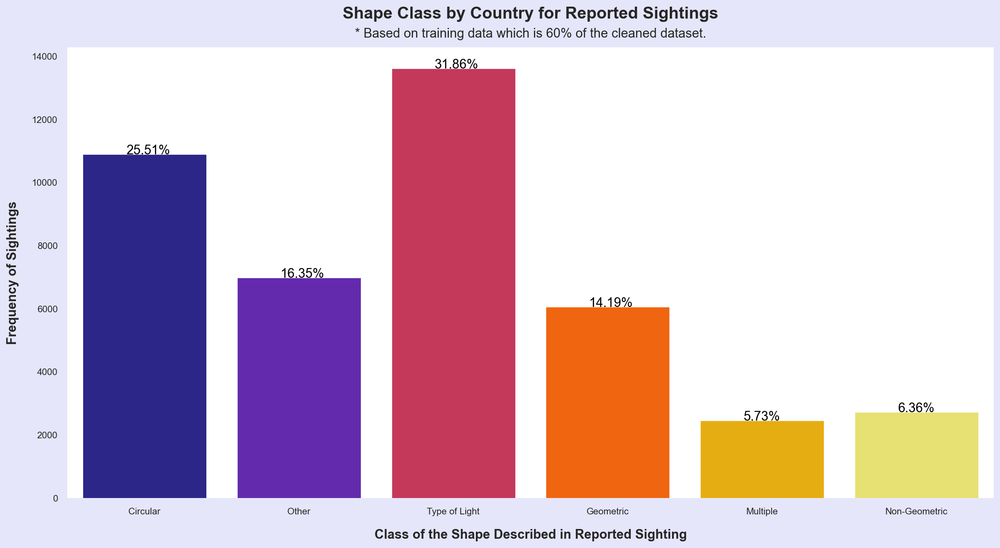

In [66]:
# Plot the frequency of my shape classes:
plt.figure(figsize=(18, 9), facecolor='lavender')
ax = sns.countplot(x='shape_class', data=train, orient='h', palette='CMRmap', saturation=1)
# ax = train[['shape_class', 'country']].value_counts().plot(kind='bar', )
ax.set_title(label=f'Shape Class by Country for Reported Sightings\n', 
             fontdict={'fontsize':18, 'fontweight':'bold'}, loc='center', pad=12)
ax.text(s='       * Based on training data which is 60% of the cleaned dataset.', fontsize=14, x=1.20, y=14600)
ax.set_ylabel('Frequency of Sightings', labelpad=14, size=14, weight='bold')
ax.set_xlabel('Class of the Shape Described in Reported Sighting', labelpad=14, size=14, weight='bold');

# Create a list to add plt.patches data to:
totals = []

# Find the values and append to totals list:
for v in ax.patches:
    totals.append(v.get_height())

# Get the individual bar labels using the list above:
tot = sum(totals)

# Set individual bar labels using the above list:
for v in ax.patches:
    ax.text(v.get_x()+0.28, v.get_height()+.5, \
           str(round((v.get_height()/tot)*100, 2))+'%', fontsize=14, color='black')

## Create X feature matrices and y target vectors:

In [67]:
# Set my features and target:
target = 'shape_class'
features = train.columns.drop([target])

# Arrange X feature matrices and y target vectors:
X_train = train[features]
y_train = train[target]
X_val = val[features]
y_val = val[target]
X_test = test[features]
y_test = test[target]

# Check my work:
X_train.head()

,Id,year,month,dow,hour,durations_in_secs,city,state,country,latitude,longitude,movement
7169,7930,2002,11,Mon,19.0,180.0,Los Angeles Area,CA,USA,34.017089,-118.288760,1.0
50302,55692,1999,7,Mon,23.0,1200.0,Elko/Carlin (Between; Near The Independence Mts.),NV,USA,40.713807,-116.103966,0.0
69383,77135,1998,9,Wed,21.0,3.0,Houston,TX,USA,29.763056,-95.363056,0.0
23666,25408,2006,1,Mon,18.0,30.0,Wellfleet,MA,USA,41.937500,-70.033333,1.0
40117,43040,2008,5,Sun,20.0,20.0,Tucson,AZ,USA,32.221667,-110.925833,1.0


## Some Visualizations:

In [68]:
# Save my train dataset to csv to upload to plotly for graphs:
train.to_csv('UFO_train.csv', index=False)

In [69]:
# Create a function in order to run plotly graphs:
def enable_plotly_in_cell():
    display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
    init_notebook_mode(connected=False)
# Need to run this function in each cell that I want to run plotly in.

In [70]:
# # Compare year, state, shape, country:
# fig_scat = go.Figure(go.Scatter(x=train['country'], y=train['state'], marker=dict(color=train['year']), hovertext=train.columns,
#                  opacity=0.4, labels={'year':'Year', 'state':'State', 'shape_class':'Shape Class', 'country':'Country'}, 
#                                 mode='markers', showlegend=True,text
#                  title=f'Interactive Scattter Plot of Data Regarding Reported UFO Sighting from 1994 to 2014 in North America'))
# enable_plotly_in_cell()
# fig_scat.show()

In [71]:
# Look at a scatter plot between year, state, and shape:
hover = train[['year', 'month', 'dow', 'hour', 'city', 'shape_class']]
fig_scat = px.scatter(train, x='state', y='year', color='country', opacity=.35, hover_data=hover, 
                 labels={'year':'Year', 'state':'State', 'shape_class':'Shape Class', 'country':'Country', 'month':'Month', 
                         'dow':'Day of the Week', 'hour':'Hour (24 hr clock)', 'city':'City'}, 
                 title='Interactive Scattter Plot of Data Regarding Reported UFO Sighting from 1994 to 2014 in North America')
fig_scat.show()

In [72]:
# Compare country and year by shape_class:
fig_vio = px.violin(train, x='country', y='year', color='shape_class', hover_data=hover, 
                    labels={'year':'Year', 'state':'State', 'shape_class':'Shape Class', 'country':'Country', 'month':'Month', 
                         'dow':'Day of the Week', 'hour':'Hour (24 hr clock)', 'city':'City'}, 
                    title='Interactive Violin Plot of Data Regarding Reported UFO Sighting from 1994 to 2014 in North America')
fig_vio.show()

In [73]:
# Map latitude and longitude:
fig_map = px.scatter_mapbox(train, lat='latitude', lon='longitude', color='shape_class', 
                        hover_data=train.columns, opacity=0.85, zoom=2)
fig_map.update_layout(mapbox_style='open-street-map', title='Shape Classes by Latitude and Longitude')
fig_map.show()

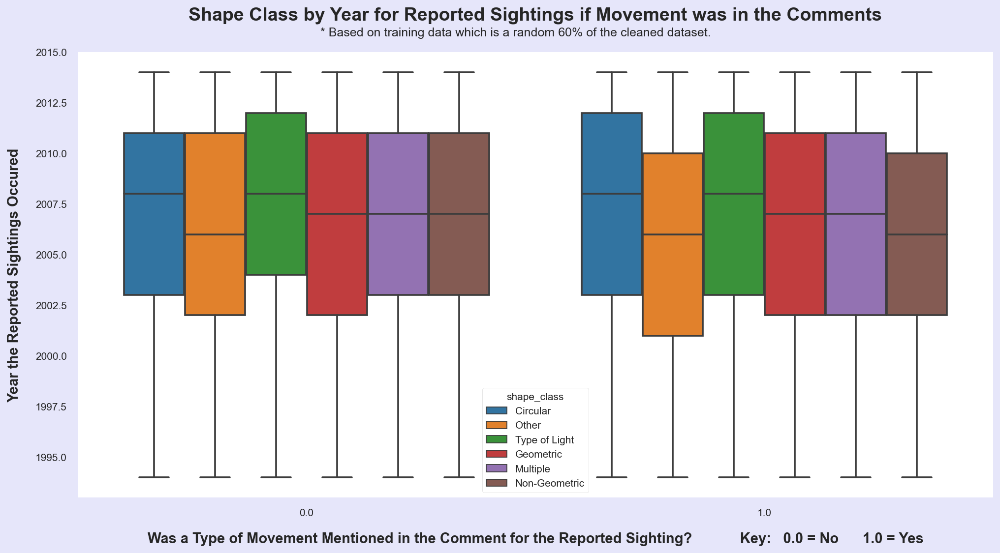

In [74]:
# Look at movement, year and shape:
fig, ax = plt.subplots(figsize=(16, 8), facecolor='lavender')
sns.boxplot(x='movement', y='year', hue='shape_class', data=train)
ax.set_title(label=f'Shape Class by Year for Reported Sightings if Movement was in the Comments\n', 
             fontdict={'fontsize':18, 'fontweight':'bold'}, loc='center', pad=12)
ax.text(s='* Based on training data which is a random 60% of the cleaned dataset.', fontsize=12, x=0.03, y=2015.8)
ax.set_ylabel('Year the Reported Sightings Occured', labelpad=14, size=14, weight='bold')
ax.set_xlabel(f'Was a Type of Movement Mentioned in the Comment for the Reported Sighting?            Key:   0.0 = No      1.0 = Yes', 
              labelpad=14, size=14, weight='bold');

## Logistic Regression:

In [75]:
# Make pipeline for logistic regression:
log_pipe = make_pipeline(ce.OrdinalEncoder(),
                        SimpleImputer(),
                        StandardScaler(),
                        LogisticRegression(random_state=97, n_jobs=-1, C=10.0, solver='newton-cg'))

# Fit on train, score on train and validate:
log_pipe.fit(X_train, y_train)
t_score = log_pipe.score(X_train, y_train)
v_score = log_pipe.score(X_val, y_val)

# Predict on test:
y_pred = log_pipe.predict(X_test)

# Look at the accuracy scores:
print ('Train Accuracy Score =', t_score)
print ('Validate Accuracy Score =', v_score)
print ('Difference between Train and Validate Score =', t_score - v_score)
print ('Test Accuracy =', accuracy_score(y_test, y_pred))

Train Accuracy Score = 0.3178392547863128
Validate Accuracy Score = 0.31885414716345256
Difference between Train and Validate Score = -0.0010148923771397533
Test Accuracy = 0.3207759137207909


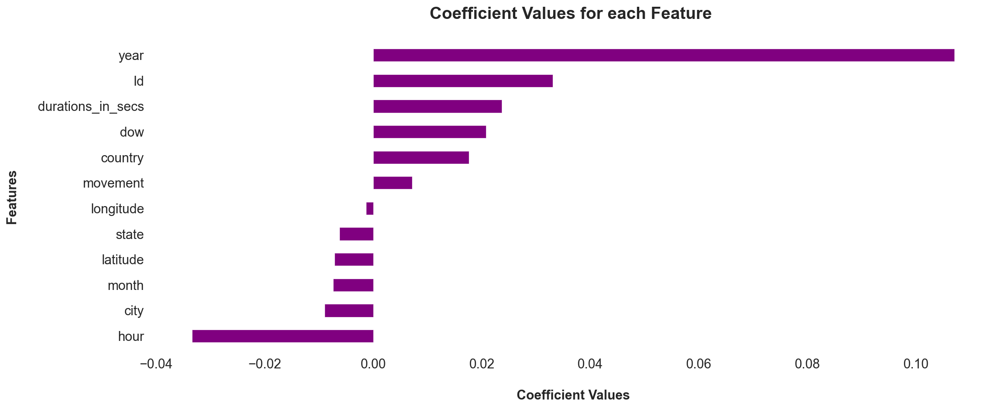

In [76]:
# Pull out elements from the pipeline:
model_lr = log_pipe.named_steps['logisticregression']
encoder_lr = log_pipe.named_steps['ordinalencoder']
encoded_lr = encoder_lr.transform(X_train).columns
coeffs = pd.Series(model_lr.coef_[0], encoded_lr)

# Plot the coefficients of my features:
plt.figure(figsize=(16, 6), facecolor='white')
coeffs.sort_values().plot.barh(color='purple')
plt.title(f'Coefficient Values for each Feature \n', size=18, weight='bold')
plt.xlabel(f'\nCoefficient Values', size=14, weight='bold')
plt.ylabel(f'Features \n', size=14, weight='bold')
plt.xticks(size=14)
plt.yticks(size=14);

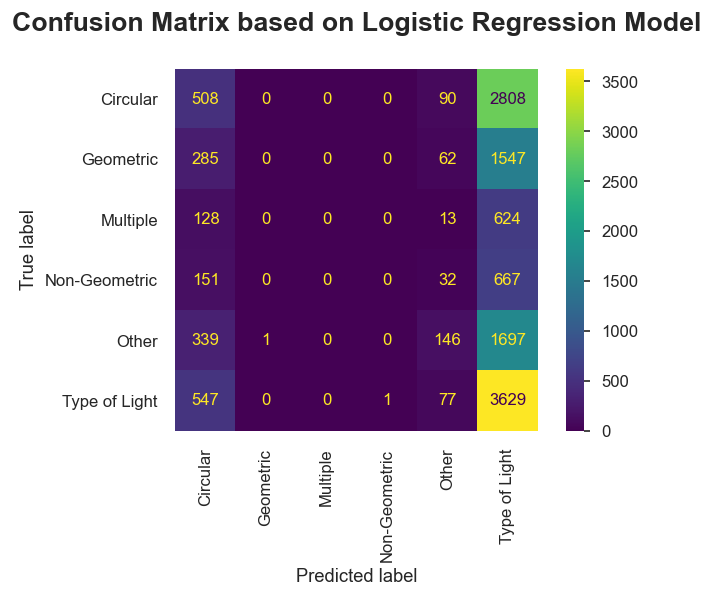

In [77]:
# Increase DPI to see the confussion matrix easier:
plt.rcParams['figure.dpi'] = 120

# Plot my confussion matrix:
plot_confusion_matrix(log_pipe, X_test, y_test, values_format='.0f', xticks_rotation='vertical')
plt.title(f'Confusion Matrix based on Logistic Regression Model\n', size=16, weight='bold');

## Random Forest:

In [78]:
# Make a pipeline for random forest:
rf_pipe = make_pipeline(ce.OrdinalEncoder(),
                       SimpleImputer(),
                       RandomForestClassifier(random_state=97, min_samples_leaf=33, max_depth=None, 
                                             n_estimators=100, max_features='auto'))

# Fit on train, score on train and validation:
rf_pipe.fit(X_train, y_train)
tr_score = rf_pipe.score(X_train, y_train)
vr_score = rf_pipe.score(X_val, y_val)

# Predict on test:
y_pred_r = rf_pipe.predict(X_test)

# Look at the accuracy scores:
print ('Train Accuracy Score =', tr_score)
print ('Validate Accuracy Score =', vr_score)
print ('Difference between Train and Validate Score =', tr_score - vr_score)
print ('Test Accuracy Score =', accuracy_score(y_test, y_pred_r))

Train Accuracy Score = 0.4075738426250995
Validate Accuracy Score = 0.3619172439618049
Difference between Train and Validate Score = 0.04565659866329458
Test Accuracy Score = 0.362866986219293


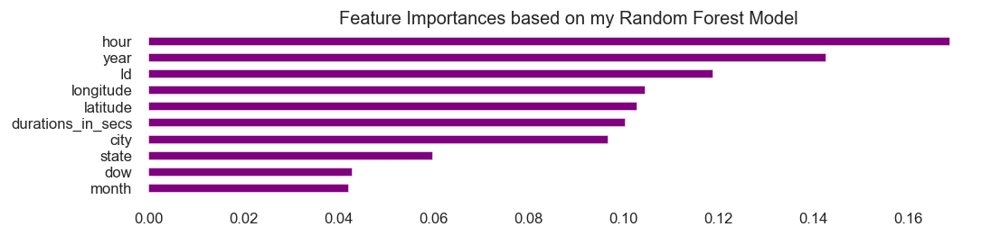

In [79]:
# Pull elements out of the pipeline to get feature importance:
encoder_rf = rf_pipe.named_steps['ordinalencoder']
encoded_rf = encoder_rf.transform(X_train)
rf = rf_pipe.named_steps['randomforestclassifier']

# Define a series for the feature importances:
feat_imp_rf = pd.Series(rf.feature_importances_, encoded_rf.columns)

# Plot the top n features:
n = 10
plt.figure(figsize=(10, n/5), facecolor='white')
feat_imp_rf.sort_values()[-n:].plot.barh(color='purple')
plt.title('Feature Importances based on my Random Forest Model');

## XGBoost:

In [80]:
# Encode for XGBoost:
encoder = ce.OrdinalEncoder()
txg_encoded = encoder.fit_transform(X_train)
vxg_encoded = encoder.transform(X_val)

# Set up model:
xg_model = XGBClassifier(n_estimators=118, 
                        max_depth=79, 
                        learning_rate=0.5,
                        n_jobs=-1)

# Set up evalulation set:
eval_set = [(txg_encoded, y_train), (vxg_encoded, y_val)]

# Fit the model:
xg_model.fit(txg_encoded, y_train, eval_set=eval_set, eval_metric='merror', early_stopping_rounds=50)

[0]	validation_0-merror:0.18532	validation_1-merror:0.72730
Multiple eval metrics have been passed: 'validation_1-merror' will be used for early stopping.

Will train until validation_1-merror hasn't improved in 50 rounds.
[1]	validation_0-merror:0.05465	validation_1-merror:0.71092
[2]	validation_0-merror:0.01458	validation_1-merror:0.70436
[3]	validation_0-merror:0.00440	validation_1-merror:0.70530
[4]	validation_0-merror:0.00136	validation_1-merror:0.69818
[5]	validation_0-merror:0.00054	validation_1-merror:0.69154
[6]	validation_0-merror:0.00026	validation_1-merror:0.68957
[7]	validation_0-merror:0.00009	validation_1-merror:0.68873
[8]	validation_0-merror:0.00002	validation_1-merror:0.69041
[9]	validation_0-merror:0.00000	validation_1-merror:0.68957
[10]	validation_0-merror:0.00000	validation_1-merror:0.68789
[11]	validation_0-merror:0.00000	validation_1-merror:0.68498
[12]	validation_0-merror:0.00000	validation_1-merror:0.68601
[13]	validation_0-merror:0.00000	validation_1-merror:0

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.5, max_delta_step=0, max_depth=79,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=118, n_jobs=-1, num_parallel_tree=1,
              objective='multi:softprob', random_state=0, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

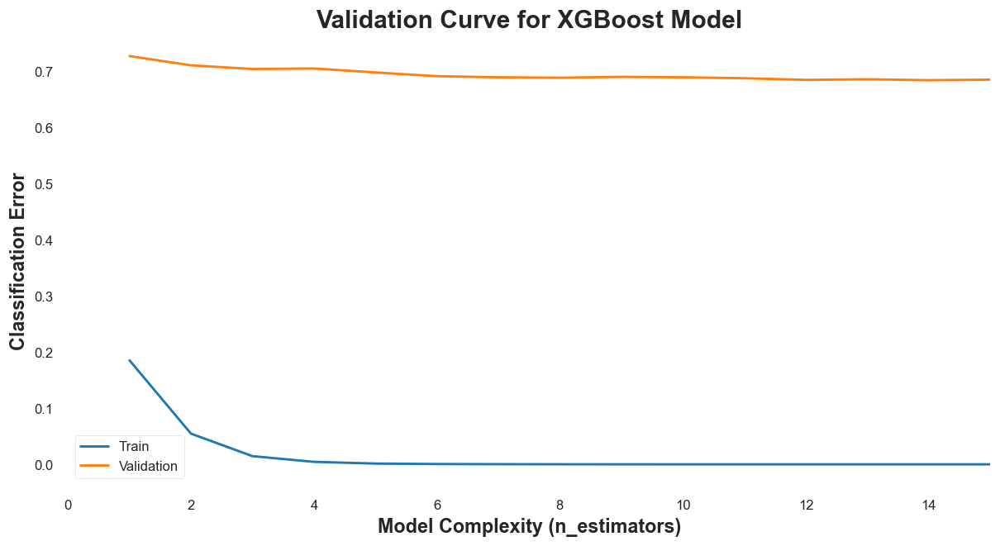

In [81]:
# Plot the validation curve from the results of my model:
results = xg_model.evals_result()
txg_err = results['validation_0']['merror']
vxg_err = results['validation_1']['merror']
epoch = list(range(1, len(txg_err) + 1))
plt.figure(figsize=(12, 6), facecolor='white')
plt.plot(epoch, txg_err, label='Train')
plt.plot(epoch, vxg_err, label='Validation')
plt.ylabel('Classification Error', size=14, weight='bold')
plt.xlabel('Model Complexity (n_estimators)', size=14, weight='bold')
plt.xlim(0, 15)
plt.title('Validation Curve for XGBoost Model', size=18, weight='bold')
plt.legend();

## Permutation Feature Importances:

In [82]:
# Build pipeline for transformers:
trans = make_pipeline(ce.OrdinalEncoder(),
                     SimpleImputer())

# Fit / transform tranformers:
t_tran = trans.fit_transform(X_train)
v_tran = trans.transform(X_val)

# Set up model:
mod = RandomForestClassifier(random_state=97, min_samples_leaf=33, max_depth=None, 
                                             n_estimators=4, max_features='auto')
mod.fit(t_tran, y_train)

# Set up the permuter:
permuter = PermutationImportance(mod, scoring='accuracy', n_iter=10, random_state=97)

# Fit the permuter:
permuter.fit(v_tran, y_val)

PermutationImportance(estimator=RandomForestClassifier(min_samples_leaf=33,
                                                       n_estimators=4,
                                                       random_state=97),
                      n_iter=10, random_state=97, scoring='accuracy')

In [83]:
# Create variable with feature names:
names = X_val.columns.tolist()

# Turn the results into a Series:
pd.Series(permuter.feature_importances_, names).sort_values(ascending=False)

hour                 0.028431
year                 0.013087
durations_in_secs    0.010139
Id                   0.006169
longitude            0.004381
month                0.004044
movement             0.002116
city                 0.001067
dow                  0.001067
state                0.000983
country              0.000440
latitude            -0.002125
dtype: float64

In [84]:
# Display importances:
eli5.show_weights(permuter, top=None, feature_names=names)

Weight,Feature
0.0284 ± 0.0061,hour
0.0131 ± 0.0078,year
0.0101 ± 0.0038,durations_in_secs
0.0062 ± 0.0060,Id
0.0044 ± 0.0048,longitude
0.0040 ± 0.0035,month
0.0021 ± 0.0024,movement
0.0011 ± 0.0020,city
0.0011 ± 0.0042,dow
0.0010 ± 0.0029,state


## PDP:

In [85]:
# Rearrange my features based on permutation importances above 0:
features = ['hour', 'year', 'durations_in_secs', 'Id', 'longitude', 'month', 'movement', 'city', 'dow', 'state']
X_train = train[features]
X_val = val[features]
X_test = test[features]

# Encode for XGBoost:
encoder = ce.OrdinalEncoder()
txg_encoded = encoder.fit_transform(X_train)
vxg_encoded = encoder.transform(X_val)
test_encoded = encoder.transform(X_test)

# Impute:
imputer = SimpleImputer(strategy='median')
txg_imp = imputer.fit_transform(txg_encoded)
vxg_imp = imputer.transform(vxg_encoded)
test_imp = imputer.transform(test_encoded)

# Need to turn encoded and imputed into a pandas dataframe:
txg_trans = pd.DataFrame(txg_imp, columns=X_train.columns)
vxg_trans = pd.DataFrame(vxg_imp, columns=X_val.columns)

# Set up my model:
xg_mod = XGBClassifier(n_estimators=118, max_depth=79, learning_rate=0.5, n_jobs=-1)

# Set up my evaluation set:
eval_set = [(txg_trans, y_train), (vxg_trans, y_val)]

# Fit my model:
xg_mod.fit(txg_trans, y_train, eval_set=eval_set, eval_metric='merror', early_stopping_rounds=10)

[0]	validation_0-merror:0.19499	validation_1-merror:0.73291
Multiple eval metrics have been passed: 'validation_1-merror' will be used for early stopping.

Will train until validation_1-merror hasn't improved in 10 rounds.
[1]	validation_0-merror:0.06060	validation_1-merror:0.71503
[2]	validation_0-merror:0.01652	validation_1-merror:0.70736
[3]	validation_0-merror:0.00498	validation_1-merror:0.70567
[4]	validation_0-merror:0.00145	validation_1-merror:0.69921
[5]	validation_0-merror:0.00044	validation_1-merror:0.70015
[6]	validation_0-merror:0.00026	validation_1-merror:0.69612
[7]	validation_0-merror:0.00009	validation_1-merror:0.69575
[8]	validation_0-merror:0.00007	validation_1-merror:0.69369
[9]	validation_0-merror:0.00005	validation_1-merror:0.69397
[10]	validation_0-merror:0.00000	validation_1-merror:0.69378
[11]	validation_0-merror:0.00000	validation_1-merror:0.69247
[12]	validation_0-merror:0.00000	validation_1-merror:0.69322
[13]	validation_0-merror:0.00000	validation_1-merror:0

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.5, max_delta_step=0, max_depth=79,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=118, n_jobs=-1, num_parallel_tree=1,
              objective='multi:softprob', random_state=0, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

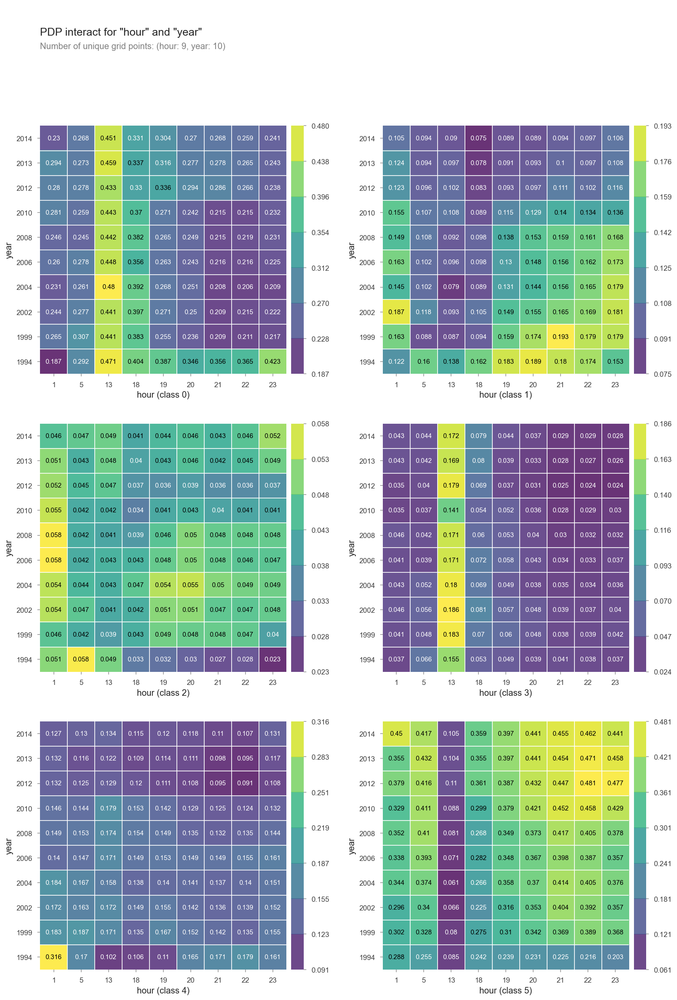

In [86]:
# Define features for the plot:
feats1 = ['hour', 'year']

# Set my perameters for the plot:
inter1 = pdp_interact(model=xg_mod, dataset=vxg_trans, features=feats1, 
                   model_features=X_val.columns)

# Create the plot:
pdp_interact_plot(inter1, plot_type='grid', feature_names=feats1);